# Credit Card Users Churn Prediction

## Description

### Background & Context

The Thera bank recently saw a steep decline in the number of users of their credit card, credit cards are a good source of income for banks because of different kinds of fees charged by the banks like annual fees, balance transfer fees, and cash advance fees, late payment fees, foreign transaction fees, and others. Some fees are charged to every user irrespective of usage, while others are charged under specified circumstances.

Customers’ leaving credit cards services would lead bank to loss, so the bank wants to analyze the data of customers and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas

You as a Data scientist at Thera bank need to come up with a classification model that will help the bank improve its services so that customers do not renounce their credit cards

You need to identify the best possible model that will give the required performance


### Objective

1. Explore and visualize the dataset.
2. Build a classification model to predict if the customer is going to churn or not
3. Optimize the model using appropriate techniques
4. Generate a set of insights and recommendations that will help the bank


### Data Dictionary:

* CLIENTNUM: Client number. Unique identifier for the customer holding the account
* Attrition_Flag: Internal event (customer activity) variable - if the account is closed then "Attrited Customer" else "Existing Customer"
* Customer_Age: Age in Years
* Gender: Gender of the account holder
* Dependent_count: Number of dependents
* Education_Level:  Educational Qualification of the account holder - Graduate, High School, Unknown, Uneducated, College(refers to a college student), Post-Graduate, Doctorate.
* Marital_Status: Marital Status of the account holder
* Income_Category: Annual Income Category of the account holder
* Card_Category: Type of Card
* Months_on_book: Period of relationship with the bank
* Total_Relationship_Count: Total no. of products held by the customer
* Months_Inactive_12_mon: No. of months inactive in the last 12 months
* Contacts_Count_12_mon: No. of Contacts between the customer and bank in the last 12 months
* Credit_Limit: Credit Limit on the Credit Card
* Total_Revolving_Bal: The balance that carries over from one month to the next is the revolving balance
* Avg_Open_To_Buy: Open to Buy refers to the amount left on the credit card to use (Average of last 12 months)
* Total_Trans_Amt: Total Transaction Amount (Last 12 months)
* Total_Trans_Ct: Total Transaction Count (Last 12 months)
* Total_Ct_Chng_Q4_Q1: Ratio of the total transaction count in 4th quarter and the total transaction count in 1st quarter
* Total_Amt_Chng_Q4_Q1: Ratio of the total transaction amount in 4th quarter and the total transaction amount in 1st quarter
* Avg_Utilization_Ratio: Represents how much of the available credit the customer spent

In [ ]:
!pip3 install tabulate

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
### IMPORT: ------------------------------------
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import scipy.stats as stats
import plotly.express as px
%matplotlib inline
import seaborn as sns
import warnings

import statsmodels.api as sm
#--Sklearn library--
from sklearn.model_selection import train_test_split,StratifiedKFold, cross_val_score # Sklearn package's randomized data splitting function

from sklearn import metrics
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    roc_auc_score,
    plot_confusion_matrix,
    plot_roc_curve,
)
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    AdaBoostClassifier,
    GradientBoostingClassifier,
    RandomForestClassifier,
    BaggingClassifier,
    StackingClassifier
)

from xgboost import XGBClassifier
from sklearn import tree
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import FunctionTransformer
from sklearn.base import TransformerMixin

# To impute missing values
from sklearn.impute import KNNImputer
# Libtune to tune model, get different metric scores

from sklearn.metrics import  classification_report, accuracy_score, precision_score, recall_score,f1_score
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay,plot_confusion_matrix #to plot confusion matric

from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import (
    StandardScaler,
    MinMaxScaler,
    OneHotEncoder,
    RobustScaler,
)

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.set_option('display.max_rows', 300)
pd.set_option('display.max_columns', 25)
pd.set_option('display.max_colwidth',200)
# To supress numerical display in scientific notations
pd.set_option('display.float_format', lambda x: '%.5f' % x) 
warnings.filterwarnings('ignore') # To supress warnings
 # set the background for the graphs
plt.style.use('ggplot')
# For pandas profiling
from pandas_profiling import ProfileReport
print('Load Libraries-Done')

Load Libraries-Done


In [ ]:
BankChurners = pd.read_csv("BankChurners.csv")

In [ ]:
data = BankChurners.copy()

In [ ]:
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.00000,777,11914.00000,1.33500,1144,42,1.62500,0.06100
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.00000,864,7392.00000,1.54100,1291,33,3.71400,0.10500
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.00000,0,3418.00000,2.59400,1887,20,2.33300,0.00000
3,769911858,Existing Customer,40,F,4,High School,NaN,Less than $40K,Blue,34,3,4,1,3313.00000,2517,796.00000,1.40500,1171,20,2.33300,0.76000
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.00000,0,4716.00000,2.17500,816,28,2.50000,0.00000


In [ ]:
data.tail()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.00000,1851,2152.00000,0.70300,15476,117,0.85700,0.46200
10123,710638233,Attrited Customer,41,M,2,NaN,Divorced,$40K - $60K,Blue,25,4,2,3,4277.00000,2186,2091.00000,0.80400,8764,69,0.68300,0.51100
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.00000,0,5409.00000,0.81900,10291,60,0.81800,0.00000
10125,717406983,Attrited Customer,30,M,2,Graduate,NaN,$40K - $60K,Blue,36,4,3,3,5281.00000,0,5281.00000,0.53500,8395,62,0.72200,0.00000
10126,714337233,Attrited Customer,43,F,2,Graduate,Married,Less than $40K,Silver,25,6,2,4,10388.00000,1961,8427.00000,0.70300,10294,61,0.64900,0.18900


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           8608 non-null   object 
 6   Marital_Status            9378 non-null   object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     10127 non-null  int64  
 13  Credit_Limit              10127 non-null  float64
 14  Total_

In [ ]:
data.shape

(10127, 21)

In [ ]:
# let's check for duplicate values in the data
data.duplicated().sum()

0

In [ ]:
# let's check for missing values in the data
round(data.isnull().sum() / data.isnull().count() * 100, 2)

CLIENTNUM                   0.00000
Attrition_Flag              0.00000
Customer_Age                0.00000
Gender                      0.00000
Dependent_count             0.00000
Education_Level            15.00000
Marital_Status              7.40000
Income_Category             0.00000
Card_Category               0.00000
Months_on_book              0.00000
Total_Relationship_Count    0.00000
Months_Inactive_12_mon      0.00000
Contacts_Count_12_mon       0.00000
Credit_Limit                0.00000
Total_Revolving_Bal         0.00000
Avg_Open_To_Buy             0.00000
Total_Amt_Chng_Q4_Q1        0.00000
Total_Trans_Amt             0.00000
Total_Trans_Ct              0.00000
Total_Ct_Chng_Q4_Q1         0.00000
Avg_Utilization_Ratio       0.00000
dtype: float64

* Education_Level column has 15.00% missing values out of the total observations.

* Marital_Status column has 7.20% missing values out of the total observations.

In [ ]:
# let's view the statistical summary of the numerical columns in the data
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127.00000,739177606.33366,36903783.45023,708082083.00000,713036770.50000,717926358.00000,773143533.00000,828343083.00000
Customer_Age,10127.00000,46.32596,8.01681,26.00000,41.00000,46.00000,52.00000,73.00000
Dependent_count,10127.00000,2.34620,1.29891,0.00000,1.00000,2.00000,3.00000,5.00000
Months_on_book,10127.00000,35.92841,7.98642,13.00000,31.00000,36.00000,40.00000,56.00000
Total_Relationship_Count,10127.00000,3.81258,1.55441,1.00000,3.00000,4.00000,5.00000,6.00000
Months_Inactive_12_mon,10127.00000,2.34117,1.01062,0.00000,2.00000,2.00000,3.00000,6.00000
Contacts_Count_12_mon,10127.00000,2.45532,1.10623,0.00000,2.00000,2.00000,3.00000,6.00000
Credit_Limit,10127.00000,8631.95370,9088.77665,1438.30000,2555.00000,4549.00000,11067.50000,34516.00000
Total_Revolving_Bal,10127.00000,1162.81406,814.98734,0.00000,359.00000,1276.00000,1784.00000,2517.00000
Avg_Open_To_Buy,10127.00000,7469.13964,9090.68532,3.00000,1324.50000,3474.00000,9859.00000,34516.00000


**Observations**

* Average customer age is ~46 and max customer age is 73.
* Average period of relationship with the bank is ~35 months with minimum of 13 and max as 56.
* Maximum Total number of product held by customer is 6 and on average is ~4.
* Mean Credit_limit 8631 while median is 4549 , indicates data has outliers and right skewed.
* Total_Revolving_Bal has mean as 1162.
* Avg_Open_To_Buy has mean 7469 and max as 34516 .This number had appeared before in credit limit. This seems to be some default value. 
* Distrubution is right skewed with some outliers on higher end.
* Total_Amt_Chng_Q4_Q1 median is 0.73600 and mean is 0.75994.
* Total_Trans_Amt has an average of 4404 and median of 3899. This indicate data is right skewed with outliers on higher end
* Total_Trans_Ct has an average value of 64.8 and median of 67. This ndicates slight skewness to the right.
* Total_Ct_Chng_Q4_Q1 has an average of 0.71 and median value of 0.702.
* Avg_Utilization_Ratio is right skewed with an average of 0.27 and median at 0.176.

In [ ]:
# let's view the statistical summary of the non-numerical columns in the data
data.describe(exclude=np.number).T

,count,unique,top,freq
Attrition_Flag,10127,2,Existing Customer,8500
Gender,10127,2,F,5358
Education_Level,8608,6,Graduate,3128
Marital_Status,9378,3,Married,4687
Income_Category,10127,6,Less than $40K,3561
Card_Category,10127,4,Blue,9436


* Attrition_Flag is the target variable 
* Categorical Variable: - 
Gender, Educational_Level, Marital_status, Income category, card_category


In [ ]:
data.select_dtypes(include="object").nunique()

Attrition_Flag     2
Gender             2
Education_Level    6
Marital_Status     3
Income_Category    6
Card_Category      4
dtype: int64

In [ ]:
data.select_dtypes(exclude="object").nunique()

CLIENTNUM                   10127
Customer_Age                   45
Dependent_count                 6
Months_on_book                 44
Total_Relationship_Count        6
Months_Inactive_12_mon          7
Contacts_Count_12_mon           7
Credit_Limit                 6205
Total_Revolving_Bal          1974
Avg_Open_To_Buy              6813
Total_Amt_Chng_Q4_Q1         1158
Total_Trans_Amt              5033
Total_Trans_Ct                126
Total_Ct_Chng_Q4_Q1           830
Avg_Utilization_Ratio         964
dtype: int64

## Data Pre-Processing 

If the cardinality of a column is high it will negatively affect the model.
* drop the CLIENTNUM column since it has different number for each column. 

The following two step are used to help in filling the null value using a KNN imputer technique  
* Education_Level, Marital_Status null values are changed with unknown. 
* Income_category abc value are replaced with Unknown 





In [ ]:
data.drop(columns=["CLIENTNUM"], inplace=True)

In [ ]:
data["Education_Level"] = data["Education_Level"].fillna("Unknown")
data["Marital_Status"] = data["Marital_Status"].fillna("Unknown")

In [ ]:
data.loc[data[data["Income_Category"] == "abc"].index, "Income_Category"] = "Unknown"

In [ ]:
## Converting the data type of categorical features to 'category'

cat_cols = ['Attrition_Flag','Gender', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category','Dependent_count','Total_Relationship_Count','Months_Inactive_12_mon','Contacts_Count_12_mon']

data[cat_cols] = data[cat_cols].astype('category')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Attrition_Flag            10127 non-null  category
 1   Customer_Age              10127 non-null  int64   
 2   Gender                    10127 non-null  category
 3   Dependent_count           10127 non-null  category
 4   Education_Level           10127 non-null  category
 5   Marital_Status            10127 non-null  category
 6   Income_Category           10127 non-null  category
 7   Card_Category             10127 non-null  category
 8   Months_on_book            10127 non-null  int64   
 9   Total_Relationship_Count  10127 non-null  category
 10  Months_Inactive_12_mon    10127 non-null  category
 11  Contacts_Count_12_mon     10127 non-null  category
 12  Credit_Limit              10127 non-null  float64 
 13  Total_Revolving_Bal       10127 non-null  int6

In [ ]:
# Below function prints unique value counts and percentages for the category/object type variables
def category_unique_value():
    for cat_cols in (
        data.select_dtypes(exclude=[np.int64, np.float64]).columns.unique().to_list()
    ):
        print("Unique values and corresponding data counts for feature: " + cat_cols)
        print("-" * 90)
        df_temp = pd.concat(
            [
                data[cat_cols].value_counts(),
                data[cat_cols].value_counts(normalize=True) * 100,
            ],
            axis=1,
        )
        df_temp.columns = ["Count", "Percentage"]
        print(df_temp)
        print("-" * 90)

In [ ]:
category_unique_value()

Unique values and corresponding data counts for feature: Attrition_Flag
------------------------------------------------------------------------------------------
                   Count  Percentage
Existing Customer   8500    83.93404
Attrited Customer   1627    16.06596
------------------------------------------------------------------------------------------
Unique values and corresponding data counts for feature: Gender
------------------------------------------------------------------------------------------
   Count  Percentage
F   5358    52.90807
M   4769    47.09193
------------------------------------------------------------------------------------------
Unique values and corresponding data counts for feature: Dependent_count
------------------------------------------------------------------------------------------
   Count  Percentage
3   2732    26.97739
2   2655    26.21704
1   1838    18.14950
4   1574    15.54261
0    904     8.92663
5    424     4.18683
---------------

Customer age has a high cardinality. So, a different column have been formed to bin the age variaty.  

In [ ]:
data['Agebin'] = pd.cut(data['Customer_Age'], bins = [25, 35,45,55,65, 75], labels = ['25-35', '36-45', '46-55', '56-65','66-75'])

In [ ]:
data.Agebin.value_counts()

46-55    4135
36-45    3742
56-65    1321
25-35     919
66-75      10
Name: Agebin, dtype: int64

## EDA 
### Univariate Analysis 

In [ ]:
fig = px.histogram(data, x='Attrition_Flag', title="Attrition_Flag", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Attrition_Flag')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Gender', title="Gender", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Gender')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Dependent_count', title="Dependent_count", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Dependent_count')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Education_Level', title="Education_Level", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Education_Level')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Marital_Status', title="Marital_Status", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Marital_Status')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Income_Category', title="Income_Category", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Income_Category')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Card_Category', title="Card_Category", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Card_Category')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Total_Relationship_Count', title="Total_Relationship_Count", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Total_Relationship_Count')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Months_Inactive_12_mon', title="Months_Inactive_12_mon", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Months_Inactive_12_mon')
fig.update_layout(bargap=0.2)

In [ ]:
fig = px.histogram(data, x='Contacts_Count_12_mon', title="Contacts_Count_12_mon", opacity=0.8, text_auto=True, width=800, height=400,
            hover_data=data.columns, color='Contacts_Count_12_mon')
fig.update_layout(bargap=0.2)

**Obeservation**
* 85% of the data is Exsiting customer while the rest is attributed customer  

* Female Customers with credit cards account for 52 percent of the total.

* Approximately 30% of clients are graduates. Customers with advanced degrees and doctorates are uncommon.

* Customers who are married account for 46% of the total. 7.4 percent of the population must be assumed to be unknown.

* Approximately 35% of the population earns less than $40,000 per year.

* 93 percent of people have a blue card. A plantinum card is held by a small percentage of clients.

* More than three bank products are used by 22% of people.

* 38% have been inactive for 3 months. Customers who have been inactive for 4,5,6 months should be explored further to discover whether there is a link between attrition and inactivity.

* 60% of those contacted 2-3 times in a 12-month period

In [ ]:
fig = px.histogram(data, x='Customer_Age', marginal="box", title="Customer_Age", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Agebin', title="Age Bin", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Agebin': ['25-35', '36-45', '46-55', '56-65','66-75']})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Months_on_book', marginal="box", title="Months_on_book", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Months_on_book', title="Months on book", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Months_on_book': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Credit_Limit', marginal="box", title="Credit_Limit", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Credit_Limit', title="Credit_Limit", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Credit_Limit': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Total_Revolving_Bal', marginal="box", title="Total_Revolving_Bal", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Total_Revolving_Bal', title="Total_Revolving_Bal", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Total_Revolving_Bal': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Avg_Open_To_Buy', marginal="box", title="Avg_Open_To_Buy", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Avg_Open_To_Buy', title="Avg Open To Buy", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Avg_Open_To_Buy': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Total_Trans_Amt', marginal="box", title="Total_Trans_Amt", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Total_Trans_Amt', title="Total Trans Amt", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Total_Trans_Amt': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Total_Trans_Ct', marginal="box", title="Total_Trans_Ct", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Total_Trans_Ct', title="Total_Trans_Ct", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Total_Trans_Ct': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Total_Ct_Chng_Q4_Q1', marginal="box", title="Total_Ct_Chng_Q4_Q1", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Total_Ct_Chng_Q4_Q1', title="Total_Ct_Chng_Q4_Q1", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Total_Ct_Chng_Q4_Q1': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Total_Amt_Chng_Q4_Q1', marginal="box", title="Total_Amt_Chng_Q4_Q1", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Total_Amt_Chng_Q4_Q1', title="Total_Amt_Chng_Q4_Q1", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Total_Amt_Chng_Q4_Q1': []})
fig.update_layout(bargap=0.2)
fig.show()

In [ ]:
fig = px.histogram(data, x='Avg_Utilization_Ratio', marginal="box", title="Avg_Utilization_Ratio", opacity=0.8, nbins=45, text_auto=True, 
                  hover_data=data.columns, color_discrete_sequence=['indianred'], width=800, height=400)
fig.update_layout(bargap=0.2)
fig.show()
fig = px.histogram(data, x='Avg_Utilization_Ratio', title="Avg_Utilization_Ratio", opacity=0.8, text_auto=True, 
            hover_data=data.columns, width=800, height=400,
            category_orders={'Avg_Utilization_Ratio': []})
fig.update_layout(bargap=0.2)
fig.show()

* Customer age is almost normaly disturbed, with a few exceptions on the higher end.
* The maximum distrubution for a month on book is roughly 35-36.
* The majority of customers have had credit cards for a long time. On both the lower and higher ends, there are numerous outliers.
* The credit card limit is skewed, with a sudden jump to 35000, which, as previously said, is the maximum limit and appears to be some type of default value.
* On the higher end, there are numerous outliers. Customers with a credit score of more than 25000 should be investigated further.
* Numerous customers with 0 revolving balance, the total revolving balance appears to have a different disturbance, followed by a nearly normal disturbance, and then a sudden peak at 2500.
* The average open to buy has a distribution that is similar to the credit card limit.
* On the lower and upper ends of the total Amt change, there are a lot of outliers. This customer has a 3.5 ratio of total amount change from Q4 to Q1, which has to be looked into further.
* Total trans amt contains a wide range of distrubution, with data ranging from 0 to 2500, 2500-5000, 750-10000, and 12500-17500. On the higher end, there are a lot of outliers.
* There are three models in total trans ct, with outliers on the higher end.
* The total ct change q4 q1 shows a regular pattern with a lot of outliers on the higher and lower ends.
* The average utlization ration is a measure of how much of a certain credit limit is actually used by the customer. It is in the range of 0.0 to 1


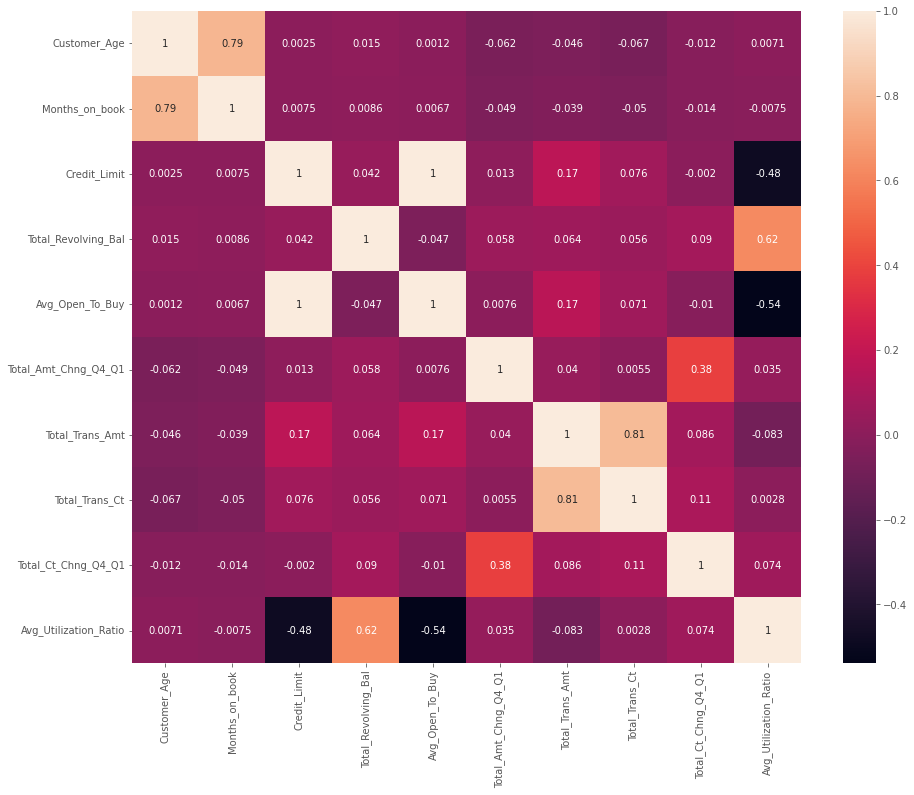

In [ ]:
sns.set_palette(sns.color_palette("Set2", 8))
plt.figure(figsize=(15,12))
sns.heatmap(data.corr(),annot=True)
plt.show()

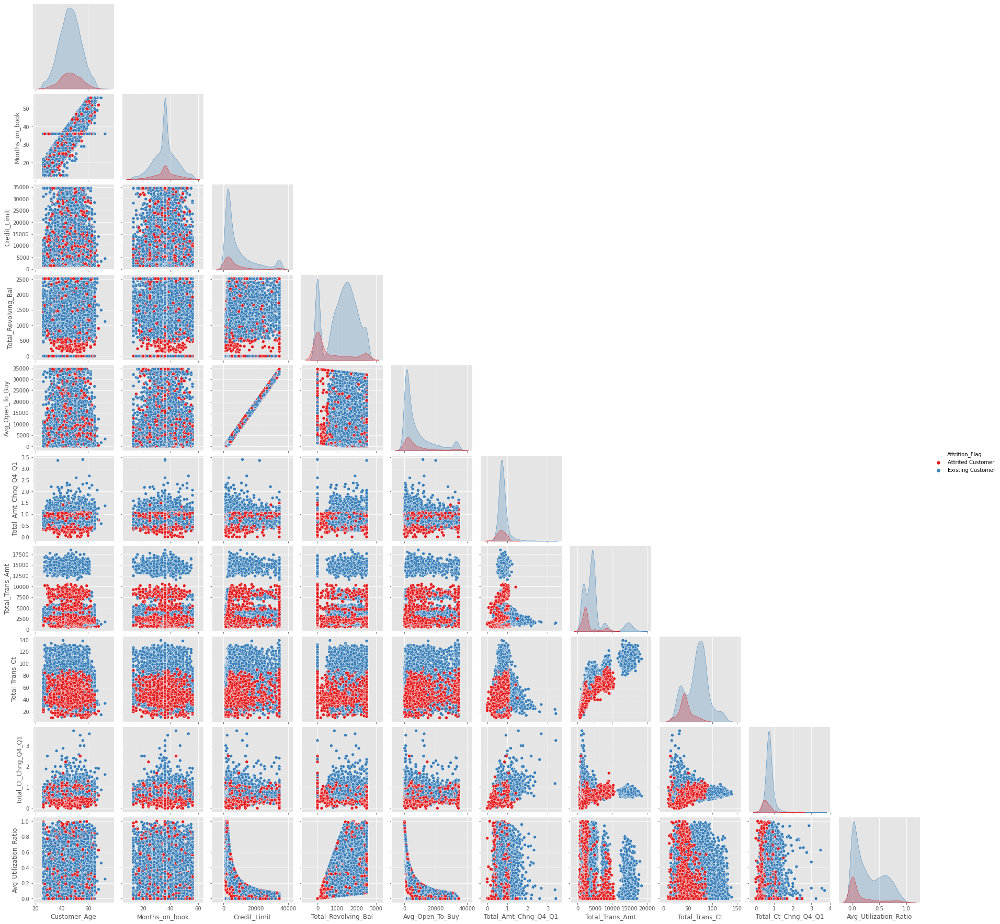

In [ ]:
sns.set_palette(sns.color_palette("Set1", 8))
sns.pairplot(data, hue="Attrition_Flag",corner=True)
plt.show()

* The amount of books a customer has and their age are closely connected.
* There is a negative association between credit limit and average utilization ratio.
* The total revolving balance and average utilization are positively correlated.
* The average opening balance is inversely proportional to the average utilization ratio.
* The total transferred amount  and the credit limit have little association.
* Total transfer amount and total transfer count have a strong association, as expected.
* Because the credit limit and the average open to buy are completely associated, we can eliminate one of them.
* Total Trans Amt is also related to Total Amt Chng Q4 Q1,total ct change q4 Q1. These characteristics appear to have been derived from Total Trans Amt. Perhaps one of these columns can be removed.

In [ ]:
### Function to plot distributions


def distribution_plot_wrt_target(data, predictor, target):

    fig, axs = plt.subplots(2, 2, figsize=(12, 10))

    target_uniq = data[target].unique()

    axs[0, 0].set_title("Distribution of target for target=" + str(target_uniq[0]))
    sns.histplot(
        data=data[data[target] == target_uniq[0]],
        x=predictor,
        kde=True,
        ax=axs[0, 0],
        color="teal",
    )

    axs[0, 1].set_title("Distribution of target for target=" + str(target_uniq[1]))
    sns.histplot(
        data=data[data[target] == target_uniq[1]],
        x=predictor,
        kde=True,
        ax=axs[0, 1],
        color="orange",
    )

    axs[1, 0].set_title("Boxplot w.r.t target")
    sns.boxplot(data=data, x=target, y=predictor, ax=axs[1, 0], palette="gist_rainbow")

    axs[1, 1].set_title("Boxplot (without outliers) w.r.t target")
    sns.boxplot(
        data=data,
        x=target,
        y=predictor,
        ax=axs[1, 1],
        showfliers=False,
        palette="gist_rainbow",
    )

    plt.tight_layout()
    plt.show()

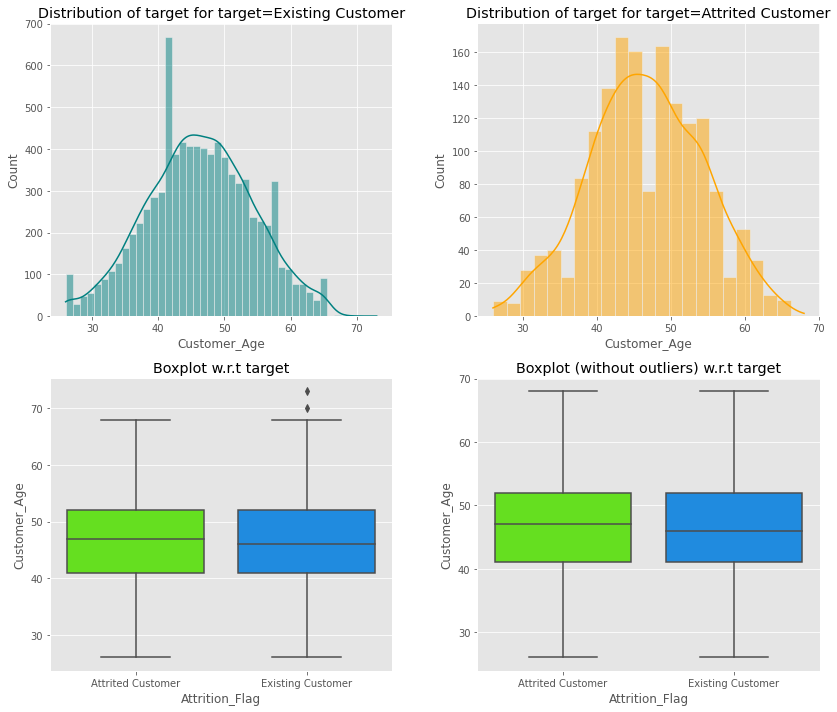

In [ ]:
distribution_plot_wrt_target(data, "Customer_Age", "Attrition_Flag")

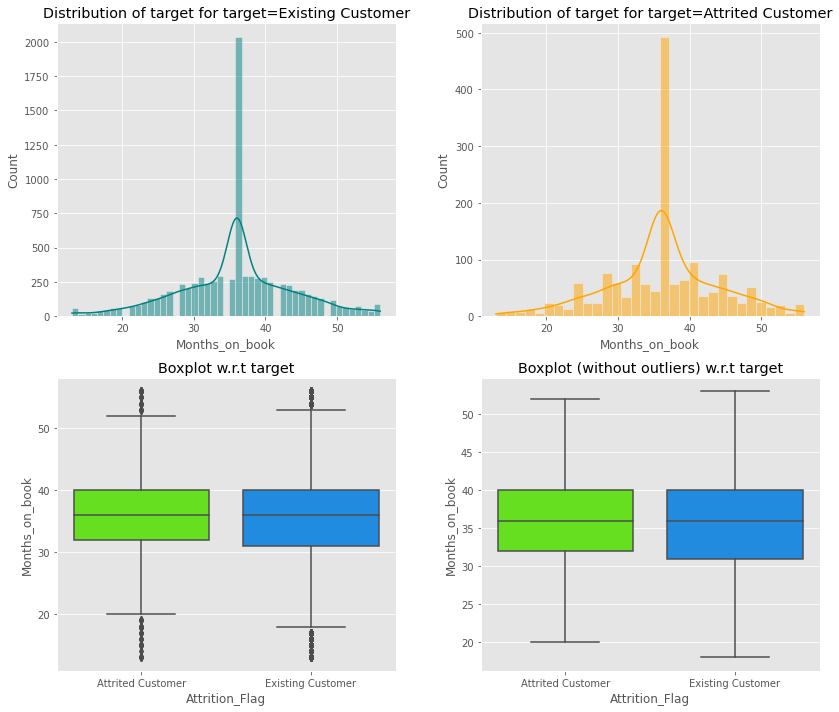

In [ ]:
distribution_plot_wrt_target(data, "Months_on_book", "Attrition_Flag")

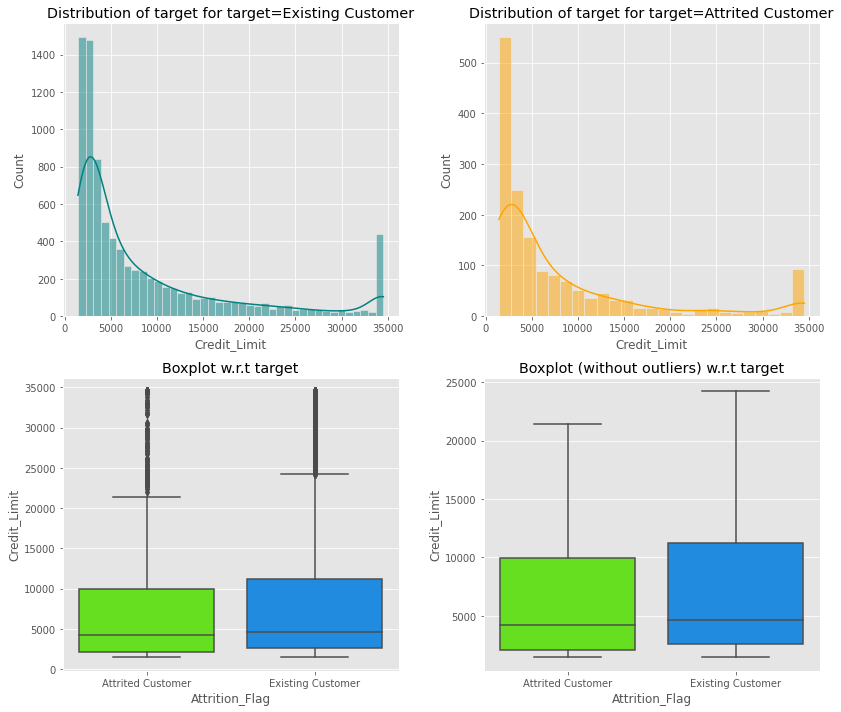

In [ ]:
distribution_plot_wrt_target(data, "Credit_Limit", "Attrition_Flag")

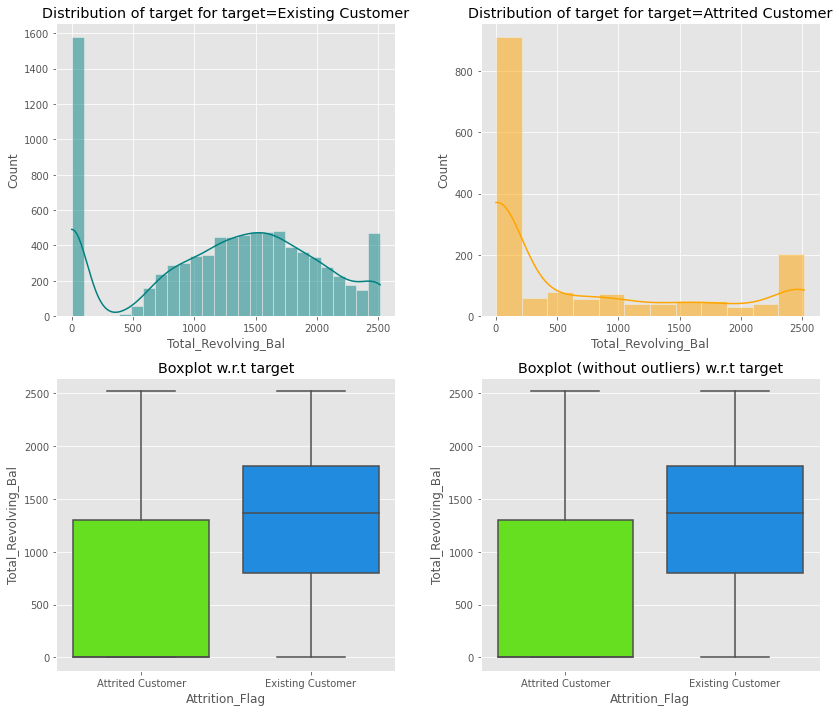

In [ ]:
distribution_plot_wrt_target(data, "Total_Revolving_Bal", "Attrition_Flag")

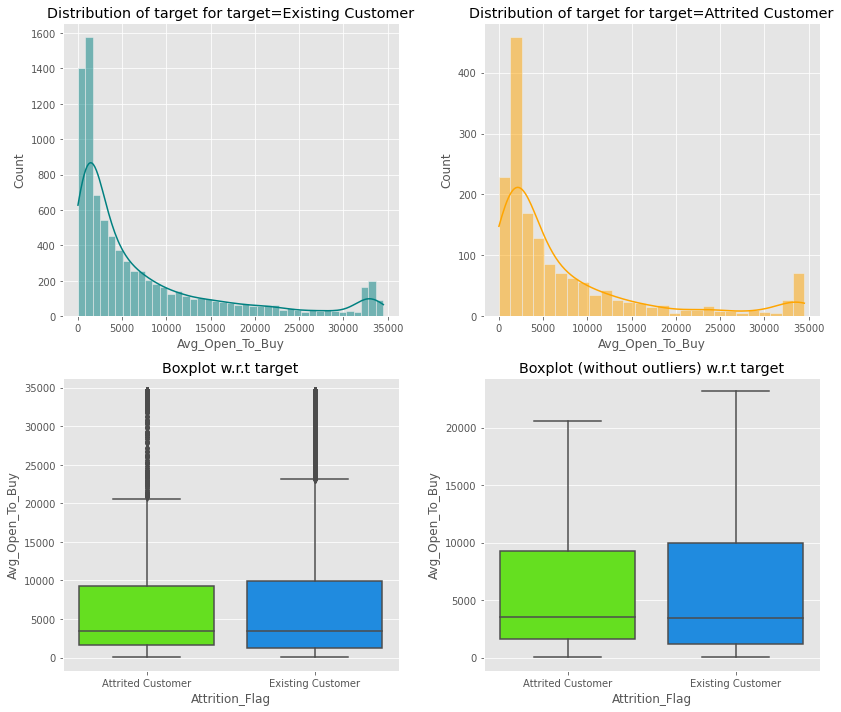

In [ ]:
distribution_plot_wrt_target(data, "Avg_Open_To_Buy", "Attrition_Flag")

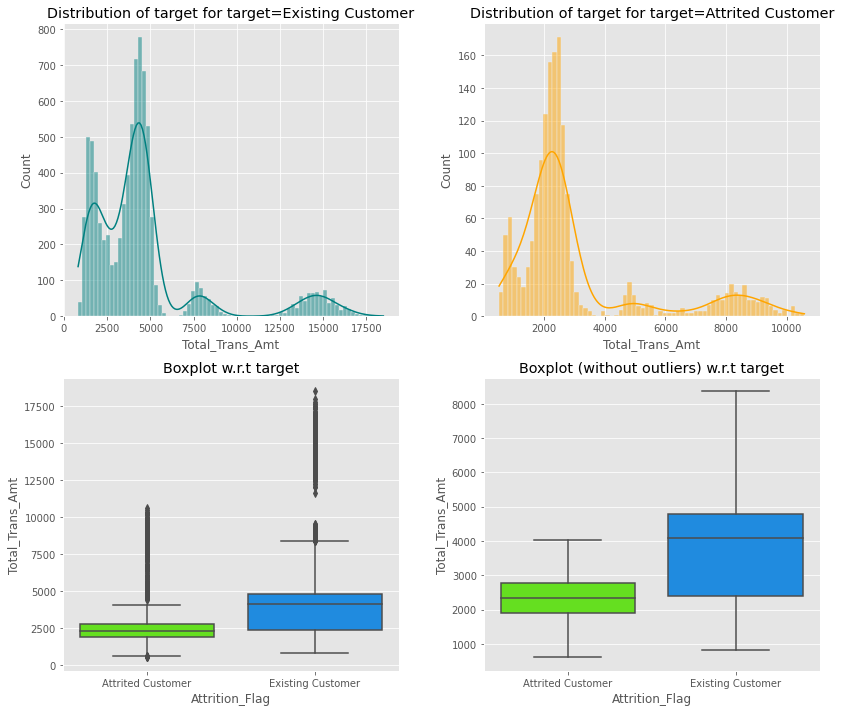

In [ ]:
distribution_plot_wrt_target(data, "Total_Trans_Amt", "Attrition_Flag")

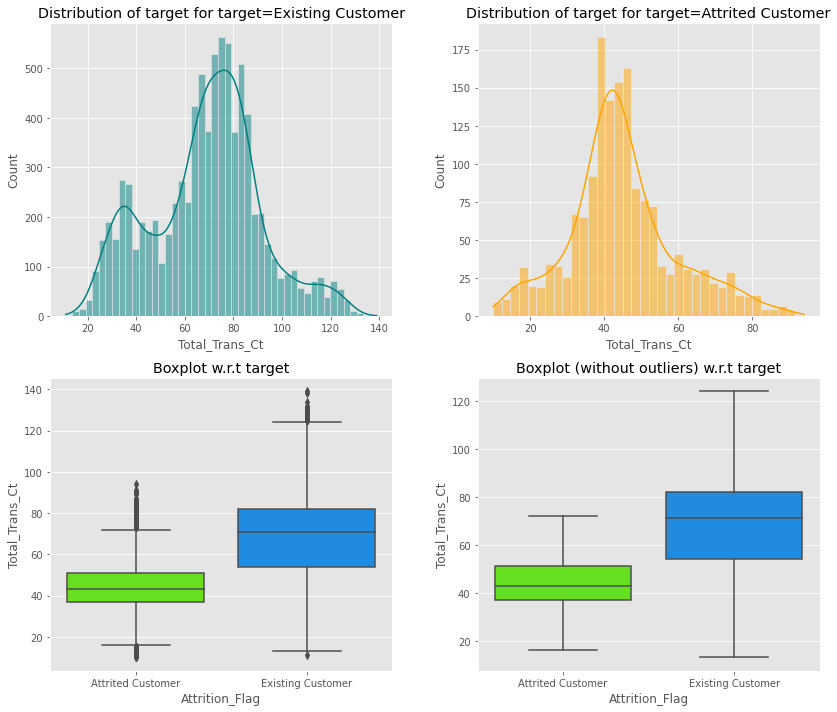

In [ ]:
distribution_plot_wrt_target(data, "Total_Trans_Ct", "Attrition_Flag")

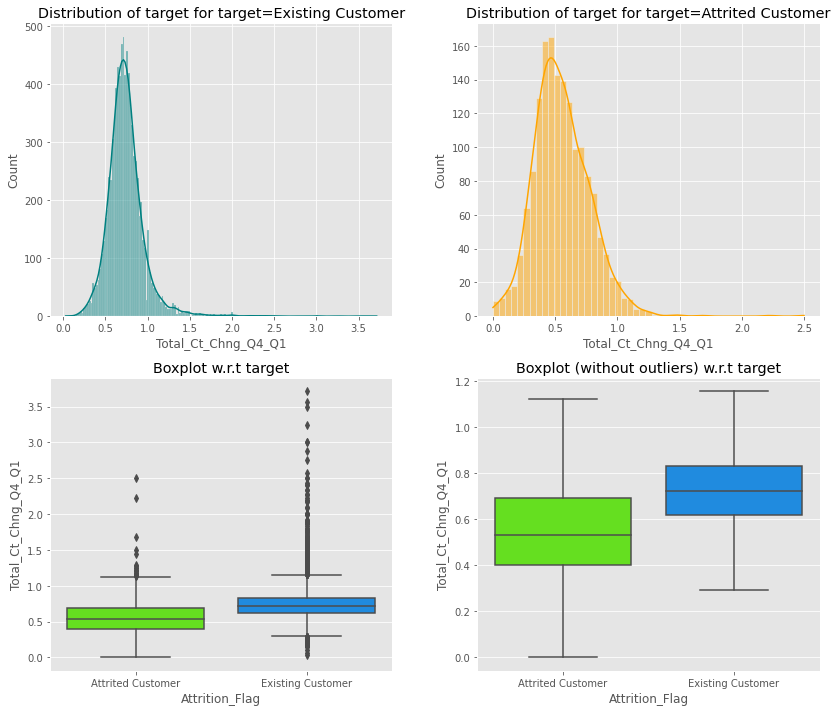

In [ ]:
distribution_plot_wrt_target(data, "Total_Ct_Chng_Q4_Q1", "Attrition_Flag")

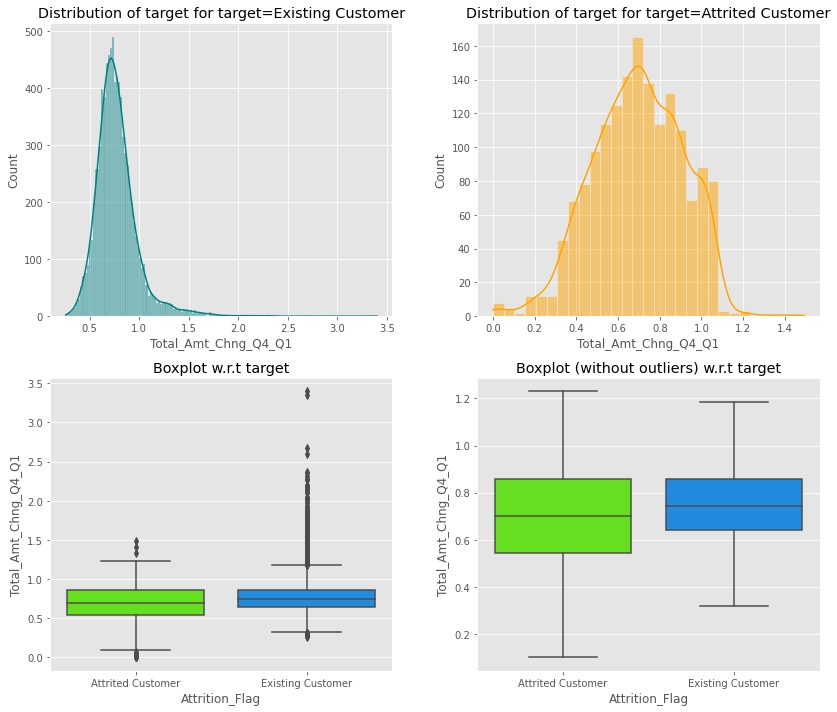

In [ ]:
distribution_plot_wrt_target(data, "Total_Amt_Chng_Q4_Q1", "Attrition_Flag")

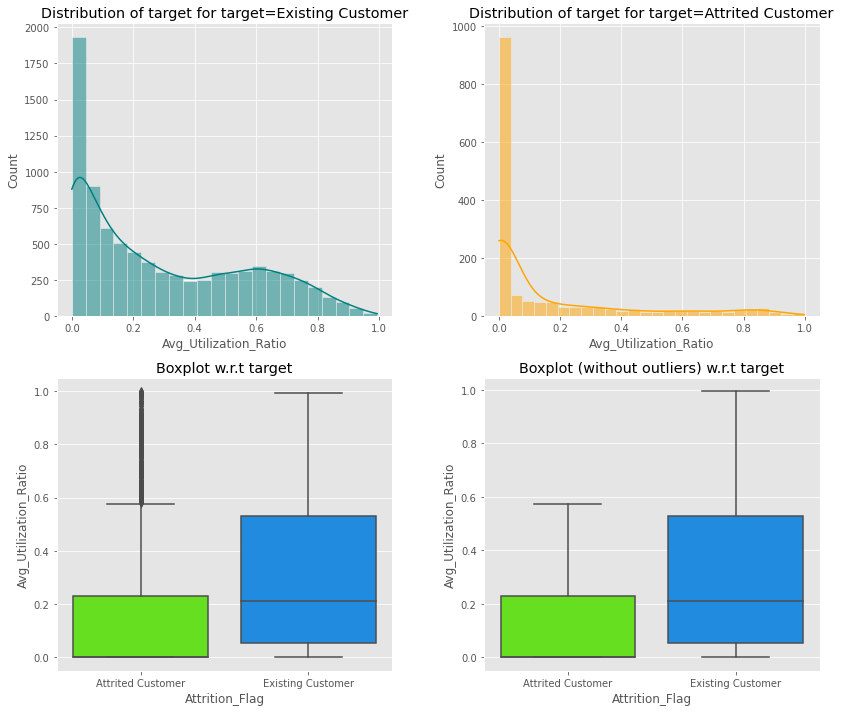

In [ ]:
distribution_plot_wrt_target(data, "Avg_Utilization_Ratio", "Attrition_Flag")

* There is no difference between attrited and Existing clients in terms of age, months on book, credit limit, or average open to buy. It doesn't appear to be related to attrition.

* Existing clients appear to have a greater Total Revolving Balance than attrition consumers.

* Customers who spent lesser transaction had a lower transaction spend Q1 Q4 change were more likely to attrite.

* Customers with a modest volume of transactions and a small change in volume between Q1 and Q4 attrited.

* Customers on averag use less frequently attrited.

Text(0.5, 1.0, 'Income vs credit')

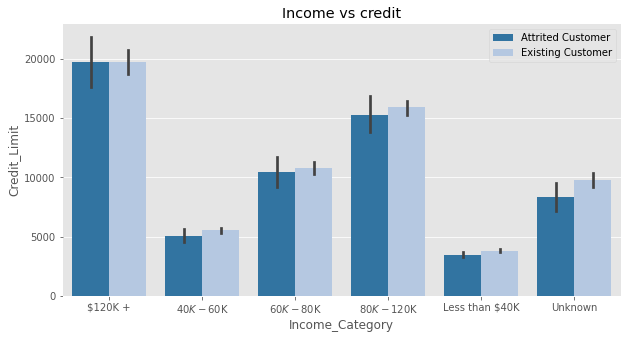

In [ ]:
plt.figure(figsize=(10,5)) 
sns.set_palette(sns.color_palette("tab20", 8))

sns.barplot(y='Credit_Limit',x='Income_Category',hue='Attrition_Flag',data=data)
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('Income vs credit')

Text(0.5, 1.0, 'CustomerAge  vs Education')

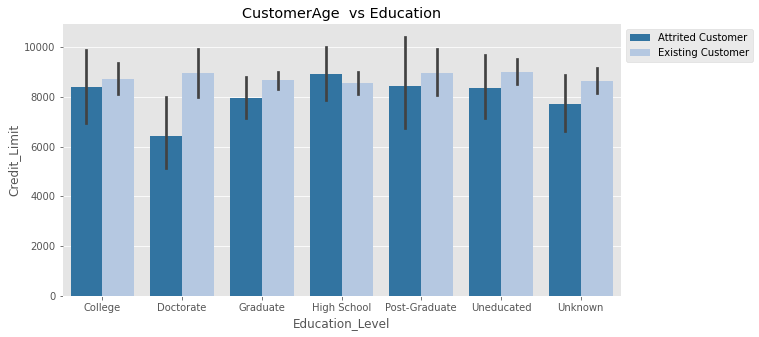

In [ ]:
plt.figure(figsize=(10,5)) 
sns.set_palette(sns.color_palette("tab20", 9))
sns.barplot(y='Credit_Limit',x='Education_Level',hue='Attrition_Flag',data=data)
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('CustomerAge  vs Education')

Text(0.5, 1.0, 'CustomerAge  vs Credit limit')

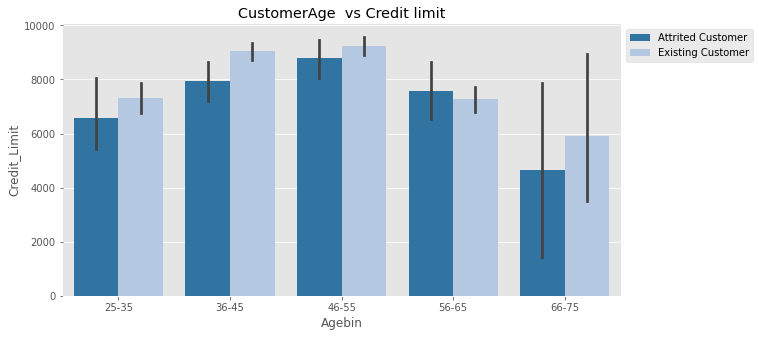

In [ ]:
plt.figure(figsize=(10,5)) 
sns.set_palette(sns.color_palette("tab20", 9))
sns.barplot(x='Agebin',y='Credit_Limit',hue='Attrition_Flag',data=data)
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('CustomerAge  vs Credit limit')

Text(0.5, 1.0, 'CustomerAge  vs Total Revolving Balance')

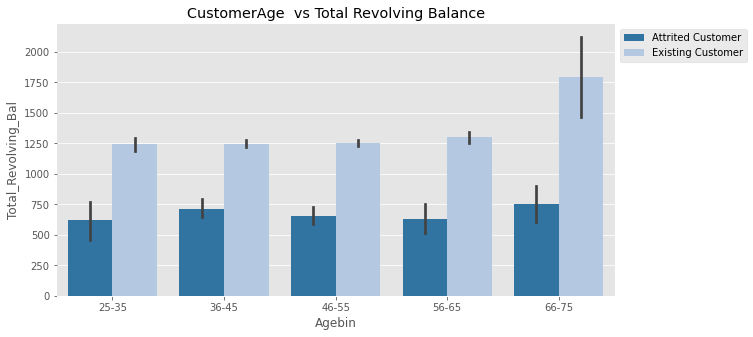

In [ ]:
plt.figure(figsize=(10,5)) 
sns.set_palette(sns.color_palette("tab20", 9))
sns.barplot(x='Agebin',y='Total_Revolving_Bal',hue='Attrition_Flag',data=data)
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('CustomerAge  vs Total Revolving Balance')

Text(0.5, 1.0, 'CustomerAge  vs Total Transcational Amount')

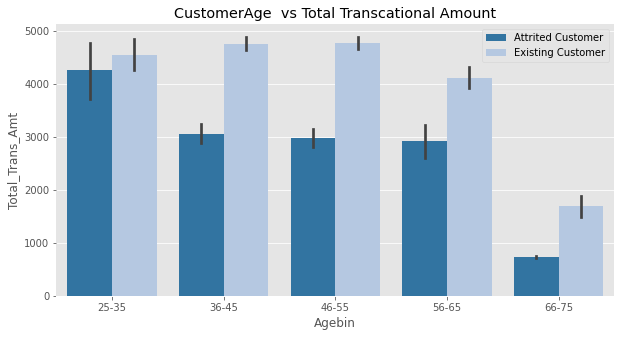

In [ ]:
plt.figure(figsize=(10,5)) 
sns.set_palette(sns.color_palette("tab20", 9))
sns.barplot(x='Agebin',y='Total_Trans_Amt',hue='Attrition_Flag',data=data)
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('CustomerAge  vs Total Transcational Amount')

Text(0.5, 1.0, 'Credit limit  vs Gender')

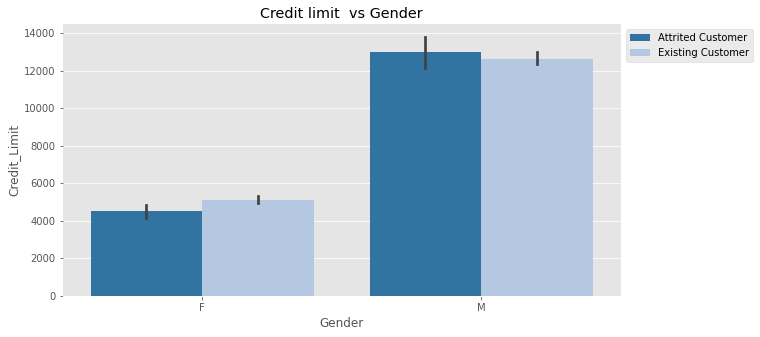

In [ ]:
plt.figure(figsize=(10,5)) 
sns.barplot(y='Credit_Limit',x='Gender',hue='Attrition_Flag',data=data) 
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('Credit limit  vs Gender')

Text(0.5, 1.0, 'Credit Limit  vs Card Category')

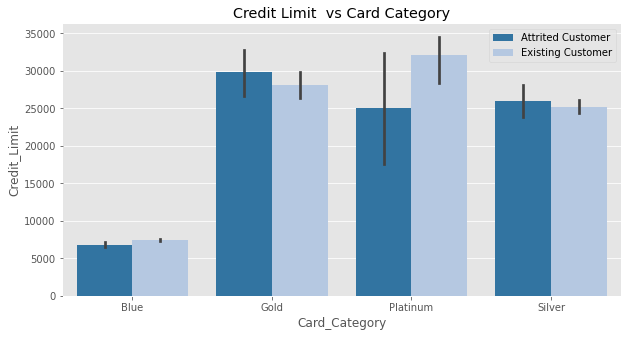

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(y='Credit_Limit',x='Card_Category',hue='Attrition_Flag',data=data) 
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('Credit Limit  vs Card Category')

Text(0.5, 1.0, 'Total Transcation Amount  vs Card')

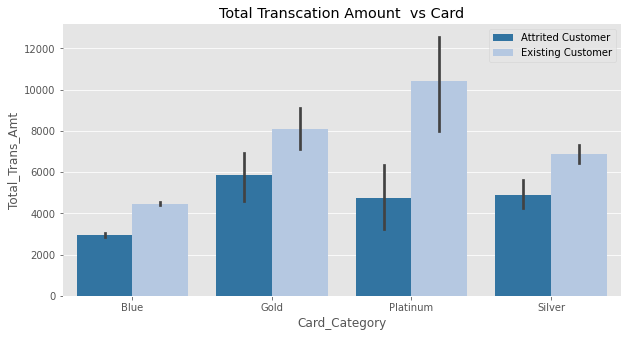

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(y='Total_Trans_Amt',x='Card_Category',hue='Attrition_Flag',data=data) 
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('Total Transcation Amount  vs Card')

Text(0.5, 1.0, 'Total Transcation Count  vs Card Category')

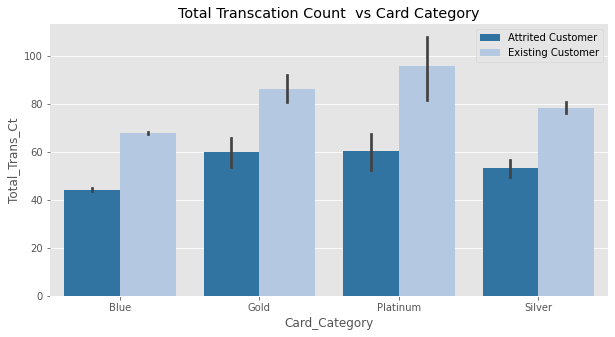

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(y='Total_Trans_Ct',x='Card_Category',hue='Attrition_Flag',data=data) 
sns.despine(top=True,right=True,left=True) # to remove side line from graph
plt.legend(bbox_to_anchor=(1.00, 1))
plt.title('Total Transcation Count  vs Card Category')

* Customers with credit scores of 35-55 were given a higher credit limit.

* The credit limit on the Plantinum card was larger.

* Customers that earned more than 120 thousand dollars had a greater credit limit.

* Male customers received a higher credit limit than female customers.

In [ ]:
# function to plot stacked bar chart


def stacked_barplot(data, predictor, target):
    """
    Print the category counts and plot a stacked bar chart

    data: dataframe
    predictor: independent variable
    target: target variable
    """
    count = data[predictor].nunique()
    sorter = data[target].value_counts().index[-1]
    tab1 = pd.crosstab(data[predictor], data[target], margins=True).sort_values(
        by=sorter, ascending=False
    )
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(data[predictor], data[target], normalize="index").sort_values(
        by=sorter, ascending=False
    )
    tab.plot(kind="bar", stacked=True, figsize=(count + 1, 5))
    plt.legend(
        loc="lower left", frameon=False,
    )
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.show()

Education_Level    College  Doctorate  Graduate  High School  Post-Graduate  \
Attrition_Flag                                                                
All                   1013        451      3128         2013            516   
Existing Customer      859        356      2641         1707            424   
Attrited Customer      154         95       487          306             92   

Education_Level    Uneducated  Unknown    All  
Attrition_Flag                                 
All                      1487     1519  10127  
Existing Customer        1250     1263   8500  
Attrited Customer         237      256   1627  
------------------------------------------------------------------------------------------------------------------------


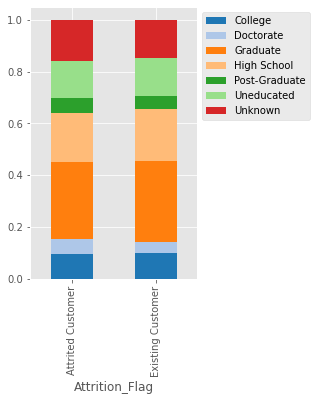

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Education_Level")

Marital_Status     Divorced  Married  Single  Unknown    All
Attrition_Flag                                              
All                     748     4687    3943      749  10127
Existing Customer       627     3978    3275      620   8500
Attrited Customer       121      709     668      129   1627
------------------------------------------------------------------------------------------------------------------------


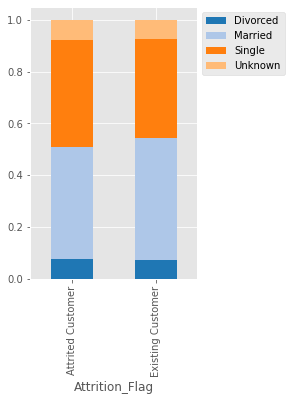

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Marital_Status")

Income_Category    $120K +  $40K - $60K  $60K - $80K  $80K - $120K  \
Attrition_Flag                                                       
All                    727         1790         1402          1535   
Existing Customer      601         1519         1213          1293   
Attrited Customer      126          271          189           242   

Income_Category    Less than $40K  Unknown    All  
Attrition_Flag                                     
All                          3561     1112  10127  
Existing Customer            2949      925   8500  
Attrited Customer             612      187   1627  
------------------------------------------------------------------------------------------------------------------------


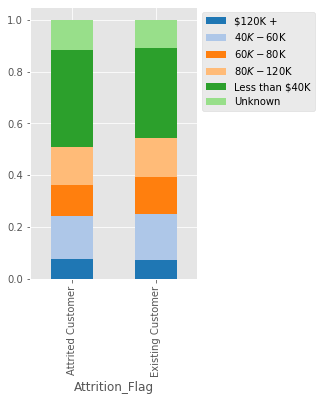

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Income_Category")

Gender                F     M    All
Attrition_Flag                      
All                5358  4769  10127
Existing Customer  4428  4072   8500
Attrited Customer   930   697   1627
------------------------------------------------------------------------------------------------------------------------


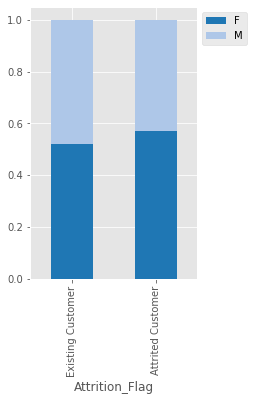

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Gender")

Card_Category      Blue  Gold  Platinum  Silver    All
Attrition_Flag                                        
All                9436   116        20     555  10127
Existing Customer  7917    95        15     473   8500
Attrited Customer  1519    21         5      82   1627
------------------------------------------------------------------------------------------------------------------------


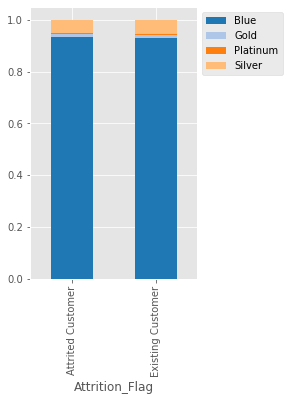

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Card_Category")

Dependent_count      0     1     2     3     4    5    All
Attrition_Flag                                            
All                904  1838  2655  2732  1574  424  10127
Existing Customer  769  1569  2238  2250  1314  360   8500
Attrited Customer  135   269   417   482   260   64   1627
------------------------------------------------------------------------------------------------------------------------


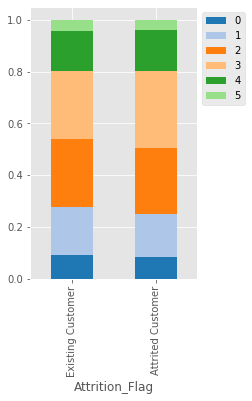

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Dependent_count")

Total_Relationship_Count    1     2     3     4     5     6    All
Attrition_Flag                                                    
All                       910  1243  2305  1912  1891  1866  10127
Existing Customer         677   897  1905  1687  1664  1670   8500
Attrited Customer         233   346   400   225   227   196   1627
------------------------------------------------------------------------------------------------------------------------


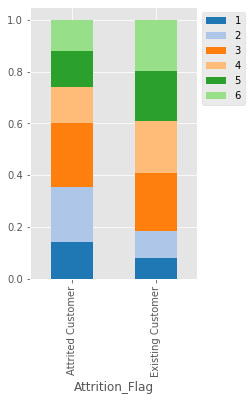

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Total_Relationship_Count")

Months_Inactive_12_mon   0     1     2     3    4    5    6    All
Attrition_Flag                                                    
All                     29  2233  3282  3846  435  178  124  10127
Attrited Customer       15   100   505   826  130   32   19   1627
Existing Customer       14  2133  2777  3020  305  146  105   8500
------------------------------------------------------------------------------------------------------------------------


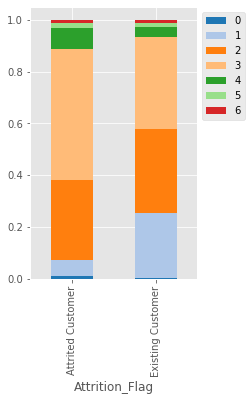

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Months_Inactive_12_mon")

Contacts_Count_12_mon    0     1     2     3     4    5   6    All
Attrition_Flag                                                    
Attrited Customer        7   108   403   681   315   59  54   1627
All                    399  1499  3227  3380  1392  176  54  10127
Existing Customer      392  1391  2824  2699  1077  117   0   8500
------------------------------------------------------------------------------------------------------------------------


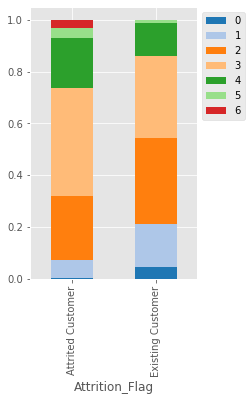

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Contacts_Count_12_mon")

Agebin             25-35  36-45  46-55  56-65  66-75    All
Attrition_Flag                                             
All                  919   3742   4135   1321     10  10127
Existing Customer    797   3136   3447   1112      8   8500
Attrited Customer    122    606    688    209      2   1627
------------------------------------------------------------------------------------------------------------------------


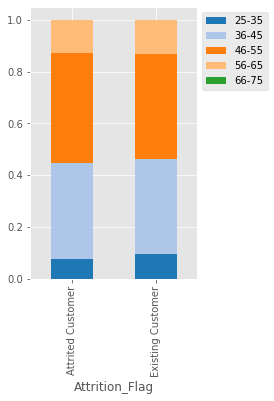

In [ ]:
stacked_barplot(data, "Attrition_Flag", "Agebin")

* In comparison to male customers, female customers attrited more.

* Customers with a doctorate or postgraduate degree were the most likely to leave.

* Customers who were single had a higher attrition rate.

* Customers with an annual income of greater than 120k but less than 40k.

* Customers that had a plantinum card had a higher attrition rate, however there were only 20 samples, thus this is an average. Customers who had a gold card had a higher attrition rate than those who had a blue or silver card. Perhaps studying the profiles of customers with various cards can aid us in identifying some patterns. With three dependents, the custimer attrited even more.

* Customers who had one or two bank products attrited more than those who had multiple bank products.

* Customers that were never inactive suffered the biggest attrition.

* We can't be certain because we just have 29 samples.

* Customers who had been inactive for four months were the most likely to leave, followed by those who had been inactive for three months and five months.

* Customers that were approached the most in the previous 12 months attrited, which is surprising.

* Did the bank have any information on their attrition, which could explain why they were contacting certain customers so frequently? or too much bank contact leads to attrition

* Customers between the ages of 66 and 75 attrited the most, however this is inclusive because we only have 18 samples.

* Customers between the ages of 36 and 55 attrited at a higher rate.

## Outlier Detection 

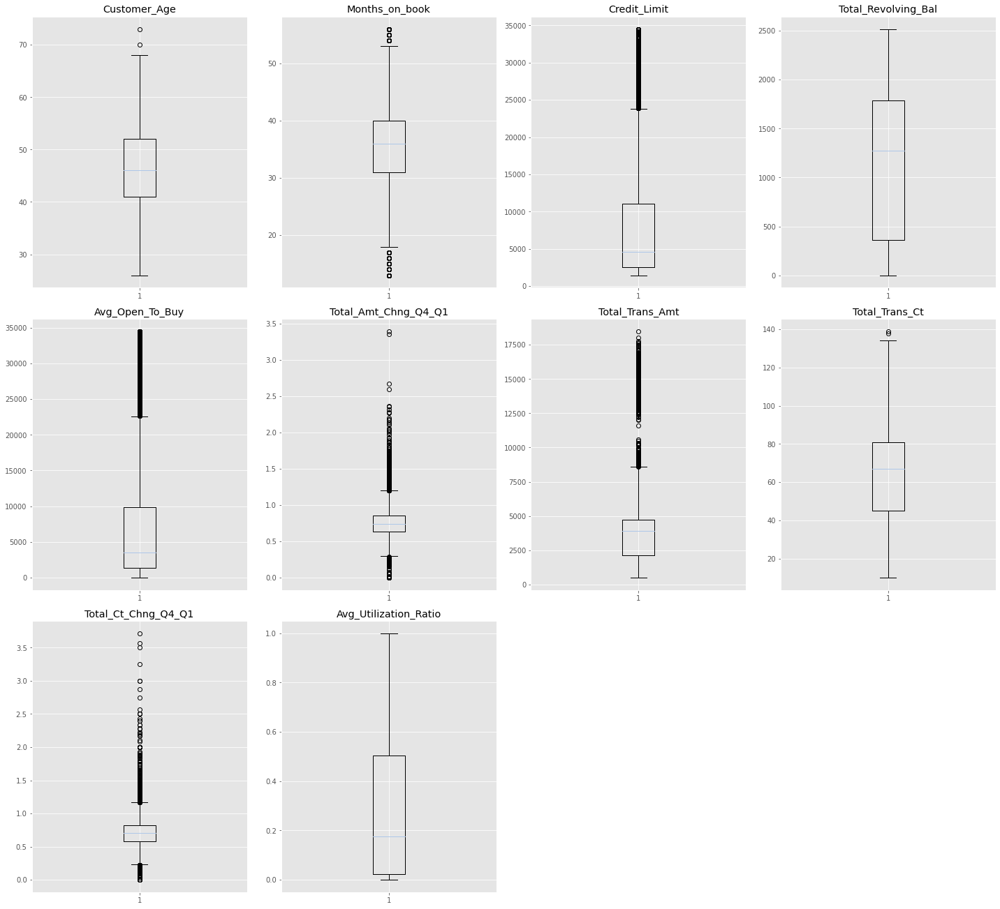

In [ ]:
numerical_col = data.select_dtypes(include=np.number).columns.tolist()
plt.figure(figsize=(20, 30))

for i, variable in enumerate(numerical_col):
    plt.subplot(5, 4, i + 1)
    plt.boxplot(data[variable], whis=1.5)
    plt.tight_layout()
    plt.title(variable)

plt.show()

In [ ]:
# functions to treat outliers by flooring and capping


def treat_outliers(df, col):
    """
    Treats outliers in a variable

    df: dataframe
    col: dataframe column
    """
    Q1 = df[col].quantile(0.25)  # 25th quantile
    Q3 = df[col].quantile(0.75)  # 75th quantile
    IQR = Q3 - Q1
    Lower_Whisker = Q1 - 1.5 * IQR
    Upper_Whisker = Q3 + 1.5 * IQR

    # all the values smaller than Lower_Whisker will be assigned the value of Lower_Whisker
    # all the values greater than Upper_Whisker will be assigned the value of Upper_Whisker
    df[col] = np.clip(df[col], Lower_Whisker, Upper_Whisker)

    return df


def treat_outliers_all(df, col_list):
    """
    Treat outliers in a list of variables

    df: dataframe
    col_list: list of dataframe columns
    """
    for c in col_list:
        df = treat_outliers(df, c)

    return df

In [ ]:
numerical_col = data.select_dtypes(include=np.number).columns.tolist()
data = treat_outliers_all(data, numerical_col)

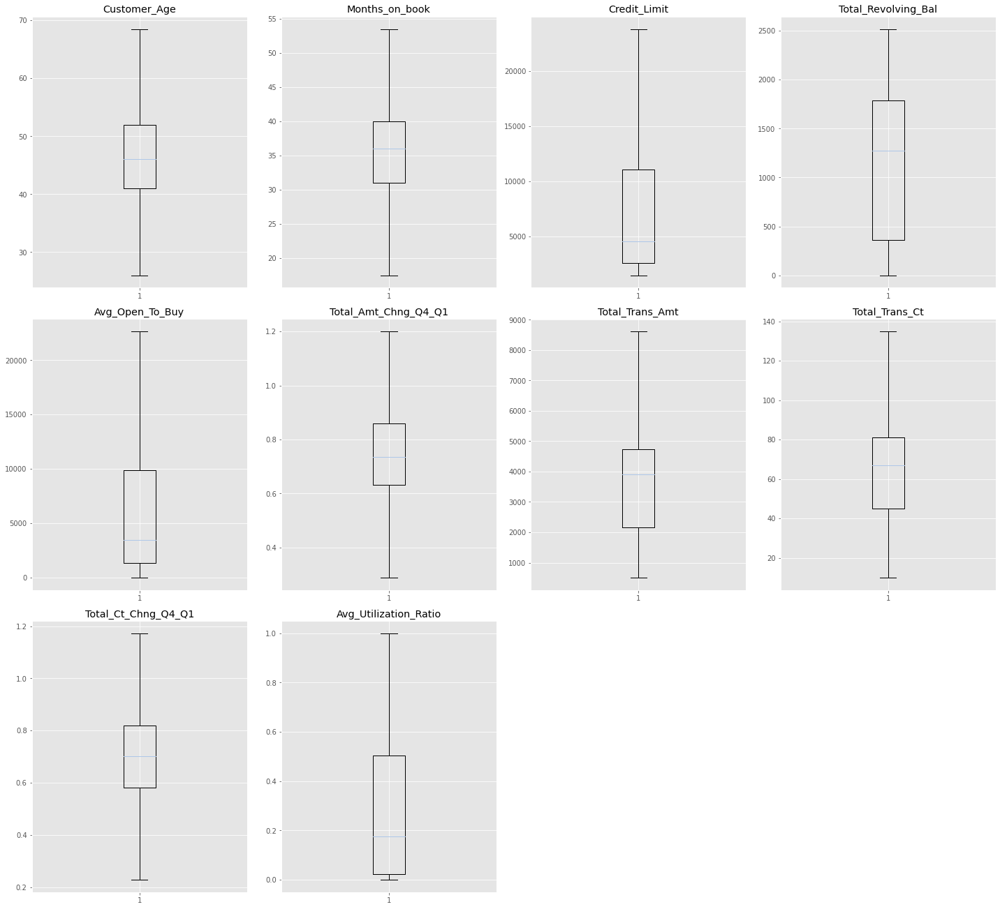

In [ ]:
# let's look at box plot to see if outliers have been treated or not
plt.figure(figsize=(20, 30))

for i, variable in enumerate(numerical_col):
    plt.subplot(5, 4, i + 1)
    plt.boxplot(data[variable], whis=1.5)
    plt.tight_layout()
    plt.title(variable)

plt.show()

## Feature Engineering

In [ ]:
# Label Encode categorical variables  
attrition = {'Existing Customer':0, 'Attrited Customer':1}
data['Attrition_Flag']=data['Attrition_Flag'].map(attrition)

marital_status = {'Married':1,'Single':2, 'Divorced':3}
data['Marital_Status']=data['Marital_Status'].map(marital_status)

education = {'Uneducated':1,'High School':2, 'Graduate':3, 'College':4, 'Post-Graduate':5, 'Doctorate':6}
data['Education_Level']=data['Education_Level'].map(education)

income = {'Less than $40K':1,'$40K - $60K':2, '$60K - $80K':3, '$80K - $120K':4, '$120K +':5}
data['Income_Category']=data['Income_Category'].map(income)

In [ ]:
## Converting the data type of categorical features to 'category'

cat_cols = ['Education_Level', 'Marital_Status', 'Income_Category']

data[cat_cols] = data[cat_cols].astype('category')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Attrition_Flag            10127 non-null  category
 1   Customer_Age              10127 non-null  float64 
 2   Gender                    10127 non-null  category
 3   Dependent_count           10127 non-null  category
 4   Education_Level           8608 non-null   category
 5   Marital_Status            9378 non-null   category
 6   Income_Category           9015 non-null   category
 7   Card_Category             10127 non-null  category
 8   Months_on_book            10127 non-null  float64 
 9   Total_Relationship_Count  10127 non-null  category
 10  Months_Inactive_12_mon    10127 non-null  category
 11  Contacts_Count_12_mon     10127 non-null  category
 12  Credit_Limit              10127 non-null  float64 
 13  Total_Revolving_Bal       10127 non-null  int6

## Split data in Train, Validation and Test sets

In [ ]:
# Separating target column
X = data.drop(['Agebin','Attrition_Flag','Avg_Open_To_Buy'],axis=1)
#X = pd.get_dummies(X,drop_first=True)
y = data['Attrition_Flag']

In [ ]:
# Splitting data into training, validation and test set:
# first we split data into 2 parts, say temporary and test

X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=1, stratify=y
)

# then we split the temporary set into train and validation

X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.25, random_state=1, stratify=y_temp
)
print(
    "Training data shape: \n\n",
    X_train.shape,
    "\n\nValidation Data Shape: \n\n",
    X_val.shape,
    "\n\nTesting Data Shape: \n\n",
    X_test.shape,
)

Training data shape: 

 (6075, 18) 

Validation Data Shape: 

 (2026, 18) 

Testing Data Shape: 

 (2026, 18)


## Missing Value Treatment 

In [ ]:
data = data.replace({'Unknown': None})

In [ ]:
data.isnull().sum()

Attrition_Flag                 0
Customer_Age                   0
Gender                         0
Dependent_count                0
Education_Level             1519
Marital_Status               749
Income_Category             1112
Card_Category                  0
Months_on_book                 0
Total_Relationship_Count       0
Months_Inactive_12_mon         0
Contacts_Count_12_mon          0
Credit_Limit                   0
Total_Revolving_Bal            0
Avg_Open_To_Buy                0
Total_Amt_Chng_Q4_Q1           0
Total_Trans_Amt                0
Total_Trans_Ct                 0
Total_Ct_Chng_Q4_Q1            0
Avg_Utilization_Ratio          0
Agebin                         0
dtype: int64

In [ ]:
imputer = KNNImputer(n_neighbors=5)

In [ ]:
reqd_col_for_impute = ['Income_Category','Education_Level','Marital_Status']

In [ ]:
#Fit and transform the train data
X_train[reqd_col_for_impute]=imputer.fit_transform(X_train[reqd_col_for_impute])

#Transform the test data 
X_val[reqd_col_for_impute]=imputer.transform(X_val[reqd_col_for_impute])

#Transform the test data 
X_test[reqd_col_for_impute]=imputer.transform(X_test[reqd_col_for_impute])

In [ ]:
# Checking that no column has missing values in train, validation or test sets
print(X_train.isna().sum())
print("-" * 30)
print(X_val.isna().sum())
print("-" * 30)
print(X_test.isna().sum())

Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64
------------------------------
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Total_Amt_Chng_Q4_Q1      

### Encoding Categorical Variable 

In [ ]:
X_train=pd.get_dummies(X_train,drop_first=True)
X_val=pd.get_dummies(X_val,drop_first=True)
X_test=pd.get_dummies(X_test,drop_first=True)
print(X_train.shape, X_val.shape, X_test.shape)

(6075, 38) (2026, 38) (2026, 38)


In [ ]:
X_train.head(3)

,Customer_Age,Education_Level,Marital_Status,Income_Category,Months_on_book,Credit_Limit,Total_Revolving_Bal,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,...,Months_Inactive_12_mon_1,Months_Inactive_12_mon_2,Months_Inactive_12_mon_3,Months_Inactive_12_mon_4,Months_Inactive_12_mon_5,Months_Inactive_12_mon_6,Contacts_Count_12_mon_1,Contacts_Count_12_mon_2,Contacts_Count_12_mon_3,Contacts_Count_12_mon_4,Contacts_Count_12_mon_5,Contacts_Count_12_mon_6
800,40.00000,2.40000,2.00000,5.00000,21.00000,20056.00000,1602,0.46600,1687.00000,46.00000,0.53300,0.08000,...,0,0,0,1,0,0,0,0,1,0,0,0
498,44.00000,3.00000,1.00000,2.40000,34.00000,2885.00000,1895,0.38700,1366.00000,31.00000,0.63200,0.65700,...,0,1,0,0,0,0,0,0,0,0,0,0
4356,48.00000,2.00000,1.00000,4.00000,36.00000,6798.00000,2517,0.87300,4327.00000,79.00000,0.88100,0.37000,...,1,0,0,0,0,0,0,1,0,0,0,0


In [ ]:
X_val.head(3)

,Customer_Age,Education_Level,Marital_Status,Income_Category,Months_on_book,Credit_Limit,Total_Revolving_Bal,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,...,Months_Inactive_12_mon_1,Months_Inactive_12_mon_2,Months_Inactive_12_mon_3,Months_Inactive_12_mon_4,Months_Inactive_12_mon_5,Months_Inactive_12_mon_6,Contacts_Count_12_mon_1,Contacts_Count_12_mon_2,Contacts_Count_12_mon_3,Contacts_Count_12_mon_4,Contacts_Count_12_mon_5,Contacts_Count_12_mon_6
2894,37.00000,5.00000,2.00000,4.00000,27.00000,15326.00000,0,1.15900,2990.00000,55.00000,0.96400,0.00000,...,0,1,0,0,0,0,0,0,1,0,0,0
9158,58.00000,1.00000,2.00000,4.00000,46.00000,10286.00000,0,0.90800,8199.00000,59.00000,0.90300,0.00000,...,0,0,1,0,0,0,1,0,0,0,0,0
9618,42.00000,1.00000,1.00000,5.00000,23.00000,23836.25000,2070,0.88000,8619.25000,102.00000,0.54500,0.06000,...,0,0,0,1,0,0,0,0,1,0,0,0


In [ ]:
X_test.head(3)

,Customer_Age,Education_Level,Marital_Status,Income_Category,Months_on_book,Credit_Limit,Total_Revolving_Bal,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,...,Months_Inactive_12_mon_1,Months_Inactive_12_mon_2,Months_Inactive_12_mon_3,Months_Inactive_12_mon_4,Months_Inactive_12_mon_5,Months_Inactive_12_mon_6,Contacts_Count_12_mon_1,Contacts_Count_12_mon_2,Contacts_Count_12_mon_3,Contacts_Count_12_mon_4,Contacts_Count_12_mon_5,Contacts_Count_12_mon_6
9760,32.00000,2.00000,2.00000,4.00000,26.00000,6407.00000,1130,0.75600,8619.25000,93.00000,0.60300,0.17600,...,0,0,1,0,0,0,0,1,0,0,0,0
7413,50.00000,5.00000,2.00000,3.00000,36.00000,2317.00000,0,0.73400,2214.00000,41.00000,0.51900,0.00000,...,0,0,1,0,0,0,0,1,0,0,0,0
6074,54.00000,2.00000,1.00000,2.00000,36.00000,3892.00000,0,0.73800,4318.00000,74.00000,0.76200,0.00000,...,0,0,1,0,0,0,0,0,1,0,0,0


In [ ]:
def make_confusion_matrix(model, test_X, y_actual, labels=[1, 0]):
    """
    model : classifier to predict values of X
    test_X: test set
    y_actual : ground truth

    """
    y_predict = model.predict(test_X)
    cm = metrics.confusion_matrix(y_actual, y_predict, labels=[1, 0])
    df_cm = pd.DataFrame(
        cm,
        index=[i for i in ["Actual - Attrited", "Actual - Existing"]],
        columns=[i for i in ["Predicted - Attrited", "Predicted - Existing"]],
    )
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)
    plt.figure(figsize=(5, 3))
    sns.heatmap(df_cm, annot=labels, fmt="", cmap="Blues").set(title="Confusion Matrix")

In [ ]:
def get_metrics_score(
    model, train, test, train_y, test_y, threshold=0.5, flag=False, roc=True
):
    """
    Function to calculate different metric scores of the model - Accuracy, Recall, Precision, and F1 score
    model: classifier to predict values of X
    train, test: Independent features
    train_y,test_y: Dependent variable
    threshold: thresold for classifiying the observation as 1
    flag: If the flag is set to True then only the print statements showing different will be displayed. The default value is set to True.
    roc: If the roc is set to True then only roc score will be displayed. The default value is set to False.
    """
    # defining an empty list to store train and test results

    score_list = []

    pred_train = model.predict_proba(train)[:, 1] > threshold
    pred_test = model.predict_proba(test)[:, 1] > threshold

    pred_train = np.round(pred_train)
    pred_test = np.round(pred_test)

    train_acc = accuracy_score(pred_train, train_y)
    test_acc = accuracy_score(pred_test, test_y)

    train_recall = recall_score(train_y, pred_train)
    test_recall = recall_score(test_y, pred_test)

    train_precision = precision_score(train_y, pred_train)
    test_precision = precision_score(test_y, pred_test)

    train_f1 = f1_score(train_y, pred_train)
    test_f1 = f1_score(test_y, pred_test)

    pred_train_proba = model.predict_proba(train)[:, 1]
    pred_test_proba = model.predict_proba(test)[:, 1]

    train_roc_auc = roc_auc_score(train_y, pred_train_proba)
    test_roc_auc = roc_auc_score(test_y, pred_test_proba)

    score_list.extend(
        (
            train_acc,
            test_acc,
            train_recall,
            test_recall,
            train_precision,
            test_precision,
            train_f1,
            test_f1,
            train_roc_auc,
            test_roc_auc,
        )
    )

    if flag == True:

        print("Accuracy on training set : ", accuracy_score(pred_train, train_y))
        print("Accuracy on test set : ", accuracy_score(pred_test, test_y))
        print("Recall on training set : ", recall_score(train_y, pred_train))
        print("Recall on test set : ", recall_score(test_y, pred_test))
        print("Precision on training set : ", precision_score(train_y, pred_train))
        print("Precision on test set : ", precision_score(test_y, pred_test))
        print("F1 on training set : ", f1_score(train_y, pred_train))
        print("F1 on test set : ", f1_score(test_y, pred_test))

    if roc == True:
        if flag == True:
            print(
                "ROC-AUC Score on training set : ",
                roc_auc_score(train_y, pred_train_proba),
            )
            print(
                "ROC-AUC Score on test set : ", roc_auc_score(test_y, pred_test_proba)
            )

    return score_list  # returning the list with train and test scores

In [ ]:
# # defining empty lists to add train and test results

model_names = []
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []
f1_train = []
f1_test = []
roc_auc_train = []
roc_auc_test = []
cross_val_train = []


def add_score_model(model_name, score, cv_res):
    """Add scores to list so that we can compare all models score together"""
    model_names.append(model_name)
    acc_train.append(score[0])
    acc_test.append(score[1])
    recall_train.append(score[2])
    recall_test.append(score[3])
    precision_train.append(score[4])
    precision_test.append(score[5])
    f1_train.append(score[6])
    f1_test.append(score[7])
    roc_auc_train.append(score[8])
    roc_auc_test.append(score[9])
    cross_val_train.append(cv_res)

## Model Building 

build 6 models:- decision tree, random forest, bagging, adaboost, gradient boosting, xgboost 

In [ ]:
models = []  # Empty list to store all the models
cv_results = []

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))
models.append(("Bagging", BaggingClassifier(random_state=1)))
models.append(("Random forest", RandomForestClassifier(random_state=1)))
models.append(("GBM", GradientBoostingClassifier(random_state=1)))
models.append(("Adaboost", AdaBoostClassifier(random_state=1)))
models.append(("Xgboost", XGBClassifier(random_state=1, eval_metric="logloss")))



results = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# For each model, run cross validation on 9 folds (+ 1 validation fold) with scoring for recall
for name, model in models:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=10, shuffle=True, random_state=1
    )  # Setting number of splits equal to 10

    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scoring, cv=kfold
    )
    cv_results.append(cv_result)

    model.fit(X_train, y_train)
    model_score = get_metrics_score(model, X_train, X_val, y_train, y_val)
    add_score_model(name, model_score, cv_result.mean())

print("Operation Completed!")

Operation Completed!


In [ ]:
comparison_frame = pd.DataFrame(
    {
        "Model": model_names,
        "Cross_Val_Score_Train": cross_val_train,
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test,
        "Train_F1": f1_train,
        "Test_F1": f1_test,
        "Train_ROC_AUC": roc_auc_train,
        "Test_ROC_AUC": roc_auc_test,
    }
)

# Sorting models in decreasing order of test recall
comparison_frame.sort_values(
    by=["Cross_Val_Score_Train", "Test_Recall"], ascending=False)

,Model,Cross_Val_Score_Train,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_F1,Test_F1,Train_ROC_AUC,Test_ROC_AUC
5,Xgboost,0.81250,0.97053,0.96446,0.86270,0.83742,0.94927,0.93493,0.90392,0.88350,0.99426,0.99071
4,Adaboost,0.81042,0.95901,0.95755,0.83504,0.82209,0.90255,0.90541,0.86748,0.86174,0.98832,0.98492
3,GBM,0.80528,0.97251,0.96347,0.87193,0.82822,0.95297,0.93750,0.91065,0.87948,0.99316,0.98767
0,dtree,0.78378,1.00000,0.93534,1.00000,0.78528,1.00000,0.80757,1.00000,0.79627,1.00000,0.87470
1,Bagging,0.78076,0.99720,0.95903,0.98668,0.81595,0.99586,0.92042,0.99125,0.86504,0.99990,0.98041
2,Random forest,0.73861,1.00000,0.95114,1.00000,0.76074,1.00000,0.92193,1.00000,0.83361,1.00000,0.98376


* The best model is XGBoost followed by Adaboost and GBM

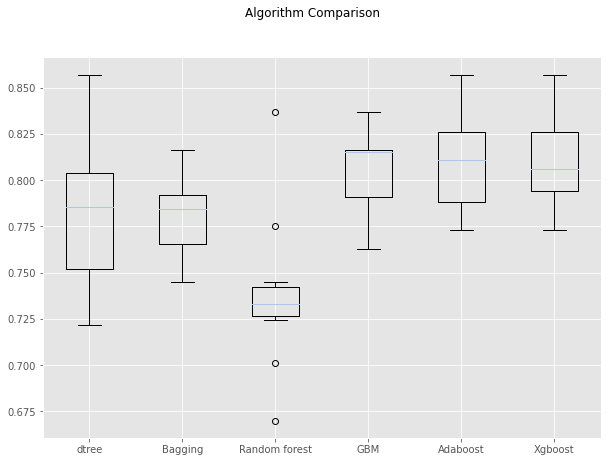

In [ ]:
# Plotting boxplots for CV scores of all models defined above
fig = plt.figure(figsize=(10, 7))

fig.suptitle("Algorithm Comparison")
ax = fig.add_subplot(111)

plt.boxplot(cv_results)
ax.set_xticklabels(model_names)

plt.show()

### Oversampling train data using SMOTE

In [ ]:
sm = SMOTE(
    sampling_strategy=1, k_neighbors=5, random_state=1
)  # Synthetic Minority Over Sampling Technique
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)

In [ ]:
print("Before Oversampling, counts of label 'Yes': {}".format(sum(y_train == 1)))
print("Before Oversampling, counts of label 'No': {} \n".format(sum(y_train == 0)))

print("After Oversampling, counts of label 'Yes': {}".format(sum(y_train_over == 1)))
print("After Oversampling, counts of label 'No': {} \n".format(sum(y_train_over == 0)))


print("After Oversampling, the shape of train_X: {}".format(X_train_over.shape))
print("After Oversampling, the shape of train_y: {} \n".format(y_train_over.shape))

Before Oversampling, counts of label 'Yes': 976
Before Oversampling, counts of label 'No': 5099 

After Oversampling, counts of label 'Yes': 5099
After Oversampling, counts of label 'No': 5099 

After Oversampling, the shape of train_X: (10198, 38)
After Oversampling, the shape of train_y: (10198,) 



In [ ]:
models_over = []

# Appending models into the list

models_over.append(("Bagging Oversampling", BaggingClassifier(random_state=1)))
models_over.append(("Random forest Oversampling", RandomForestClassifier(random_state=1)))
models_over.append(("GBM Oversampling", GradientBoostingClassifier(random_state=1)))
models_over.append(("Adaboost Oversampling", AdaBoostClassifier(random_state=1)))
models_over.append(("Xgboost Oversampling", XGBClassifier(random_state=1, eval_metric='logloss')))
models_over.append(("dtree Oversampling", DecisionTreeClassifier(random_state=1)))

for name, model in models_over:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=10, shuffle=True, random_state=1
    )  # Setting number of splits equal to 10

    cv_result_over = cross_val_score(
        estimator=model, X=X_train_over, y=y_train_over, scoring=scoring, cv=kfold
    )
    cv_results.append(cv_result_over)

    model.fit(X_train_over, y_train_over)
    model_score_over = get_metrics_score(
        model, X_train_over, X_val, y_train_over, y_val
    )
    add_score_model(name, model_score_over, cv_result_over.mean())

print("Operation Completed!")

Operation Completed!


### Oversampled data

In [ ]:
comparison_frame = pd.DataFrame(
    {
        "Model": model_names,
        "Cross_Val_Score_Train": cross_val_train,
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test,
        "Train_F1": f1_train,
        "Test_F1": f1_test,
        "Train_ROC_AUC": roc_auc_train,
        "Test_ROC_AUC": roc_auc_test,
    }
)

# Sorting models in decreasing order of test recall
comparison_frame.sort_values(
    by=["Test_Recall", "Cross_Val_Score_Train"], ascending=False)

,Model,Cross_Val_Score_Train,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_F1,Test_F1,Train_ROC_AUC,Test_ROC_AUC
10,Xgboost Oversampling,0.97490,0.98000,0.95805,0.98157,0.88957,0.97849,0.85546,0.98003,0.87218,0.99827,0.98770
8,GBM Oversampling,0.97431,0.98127,0.95854,0.98274,0.88650,0.97986,0.86012,0.98130,0.87311,0.99842,0.98856
9,Adaboost Oversampling,0.96705,0.96813,0.94768,0.96980,0.87423,0.96658,0.81429,0.96818,0.84320,0.99592,0.98106
5,Xgboost,0.81250,0.97053,0.96446,0.86270,0.83742,0.94927,0.93493,0.90392,0.88350,0.99426,0.99071
3,GBM,0.80528,0.97251,0.96347,0.87193,0.82822,0.95297,0.93750,0.91065,0.87948,0.99316,0.98767
4,Adaboost,0.81042,0.95901,0.95755,0.83504,0.82209,0.90255,0.90541,0.86748,0.86174,0.98832,0.98492
6,Bagging Oversampling,0.96509,0.99794,0.94324,0.99725,0.81595,0.99863,0.82866,0.99794,0.82226,0.99998,0.97003
1,Bagging,0.78076,0.99720,0.95903,0.98668,0.81595,0.99586,0.92042,0.99125,0.86504,0.99990,0.98041
7,Random forest Oversampling,0.97137,1.00000,0.94768,1.00000,0.80061,1.00000,0.86424,1.00000,0.83121,1.00000,0.98155
11,dtree Oversampling,0.95254,1.00000,0.92349,1.00000,0.80061,1.00000,0.74359,1.00000,0.77105,1.00000,0.87384


The best performing model was Xgboost oversampling followed by GBM oversampling and Adaboost oversampling 

### Undersampled data 

In [ ]:
rus = RandomUnderSampler(random_state=1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

In [ ]:
print("Before Under Sampling, counts of label 'Yes': {}".format(sum(y_train == 1)))
print("Before Under Sampling, counts of label 'No': {} \n".format(sum(y_train == 0)))

print("After Under Sampling, counts of label 'Yes': {}".format(sum(y_train_un == 1)))
print("After Under Sampling, counts of label 'No': {} \n".format(sum(y_train_un == 0)))

print("After Under Sampling, the shape of train_X: {}".format(X_train_un.shape))
print("After Under Sampling, the shape of train_y: {} \n".format(y_train_un.shape))

Before Under Sampling, counts of label 'Yes': 976
Before Under Sampling, counts of label 'No': 5099 

After Under Sampling, counts of label 'Yes': 976
After Under Sampling, counts of label 'No': 976 

After Under Sampling, the shape of train_X: (1952, 38)
After Under Sampling, the shape of train_y: (1952,) 



In [ ]:
models_under = []

# Appending models into the list

models_under.append(("Bagging DownSampling", BaggingClassifier(random_state=1)))
models_under.append(
    ("Random forest DownSampling", RandomForestClassifier(random_state=1))
)
models_under.append(("GBM DownSampling", GradientBoostingClassifier(random_state=1)))
models_under.append(("Adaboost DownSampling", AdaBoostClassifier(random_state=1)))
models_under.append(
    ("Xgboost DownSampling", XGBClassifier(random_state=1, eval_metric='logloss'))
)
models_under.append(("dtree DownSampling", DecisionTreeClassifier(random_state=1)))


for name, model in models_under:
    scoring = "recall"
    kfold = StratifiedKFold(
        n_splits=10, shuffle=True, random_state=1
    )  # Setting number of splits equal to 10

    cv_result_under = cross_val_score(
        estimator=model, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold
    )
    cv_results.append(cv_result_under)

    model.fit(X_train_un, y_train_un)
    model_score_under = get_metrics_score(model, X_train_un, X_val, y_train_un, y_val)
    add_score_model(name, model_score_under, cv_result_under.mean())

print("Operation Completed!")

Operation Completed!


In [ ]:
comparison_frame = pd.DataFrame(
    {
        "Model": model_names,
        "Cross_Val_Score_Train": cross_val_train,
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test,
        "Train_F1": f1_train,
        "Test_F1": f1_test,
        "Train_ROC_AUC": roc_auc_train,
        "Test_ROC_AUC": roc_auc_test,
    }
)

# Sorting models in decreasing order of test recall
comparison_frame.sort_values(
    by=["Test_Recall", "Cross_Val_Score_Train"], ascending=False)

,Model,Cross_Val_Score_Train,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_F1,Test_F1,Train_ROC_AUC,Test_ROC_AUC
16,Xgboost DownSampling,0.94977,0.96824,0.93090,0.97541,0.95092,0.96162,0.71429,0.96846,0.81579,0.99539,0.98841
15,Adaboost DownSampling,0.93027,0.94314,0.92300,0.94672,0.94479,0.93998,0.69058,0.94334,0.79793,0.99068,0.98154
14,GBM DownSampling,0.94875,0.97131,0.93139,0.97746,0.93865,0.96559,0.72000,0.97149,0.81491,0.99691,0.98774
13,Random forest DownSampling,0.93234,1.00000,0.93090,1.00000,0.93252,1.00000,0.72038,1.00000,0.81283,1.00000,0.97705
12,Bagging DownSampling,0.91593,0.99232,0.92300,0.98566,0.91411,0.99896,0.69953,0.99226,0.79255,0.99987,0.96898
10,Xgboost Oversampling,0.97490,0.98000,0.95805,0.98157,0.88957,0.97849,0.85546,0.98003,0.87218,0.99827,0.98770
17,dtree DownSampling,0.89440,1.00000,0.88598,1.00000,0.88957,1.00000,0.59794,1.00000,0.71517,1.00000,0.88743
8,GBM Oversampling,0.97431,0.98127,0.95854,0.98274,0.88650,0.97986,0.86012,0.98130,0.87311,0.99842,0.98856
9,Adaboost Oversampling,0.96705,0.96813,0.94768,0.96980,0.87423,0.96658,0.81429,0.96818,0.84320,0.99592,0.98106
5,Xgboost,0.81250,0.97053,0.96446,0.86270,0.83742,0.94927,0.93493,0.90392,0.88350,0.99426,0.99071


The best performing model was Xgboost downsampling followed by GBM downsampling and Adaboost downsampling

## Hyperparameter Tuning using random search 

### Adaboost with downsampled data 

In [ ]:
%%time

# Creating pipeline
pipe_ada_ran = make_pipeline(StandardScaler(), AdaBoostClassifier(random_state=1))

# Parameter grid to pass in GridSearchCV
param_grid = {
    "adaboostclassifier__n_estimators": np.arange(10, 110, 10),
    "adaboostclassifier__learning_rate": [0.1, 0.01, 0.2, 0.05, 1],
    "adaboostclassifier__base_estimator": [
        DecisionTreeClassifier(max_depth=1, random_state=1),
        DecisionTreeClassifier(max_depth=2, random_state=1),
        DecisionTreeClassifier(max_depth=3, random_state=1),
    ],
}
# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
abc_rand_cv = RandomizedSearchCV(estimator=pipe_ada_ran, param_distributions=param_grid, n_iter=10,n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
abc_rand_cv.fit(X_train_un, y_train_un)


print("Best parameters are {} with CV score={}:" .format(abc_rand_cv.best_params_,abc_rand_cv.best_score_))

Best parameters are {'adaboostclassifier__n_estimators': 70, 'adaboostclassifier__learning_rate': 0.1, 'adaboostclassifier__base_estimator': DecisionTreeClassifier(max_depth=2, random_state=1)} with CV score=0.9395499738356883:
CPU times: user 1.12 s, sys: 100 ms, total: 1.22 s
Wall time: 14.3 s


In [ ]:
# Creating new pipeline with best parameters
adb_tuned = make_pipeline(
    StandardScaler(), AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2,
                                                                              random_state=1),
                                        learning_rate=1, n_estimators=70))

# Fit the model on training data
adb_tuned.fit(X_train_un, y_train_un)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('adaboostclassifier',
                 AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2,
                                                                          random_state=1),
                                    learning_rate=1, n_estimators=70))])

In [ ]:
ada_tuned_model_score = get_metrics_score(
    adb_tuned, X_train, X_val, y_train, y_val
)

kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)

scoring = "recall"
ada_down_cv = cross_val_score(
    estimator=adb_tuned, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold
)


add_score_model(
    "AdaBoost Tuned with Down Sampling", ada_tuned_model_score, ada_down_cv.mean()
)

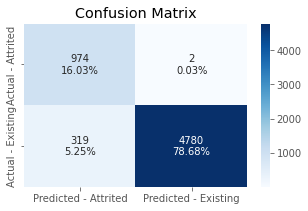

In [ ]:
make_confusion_matrix(adb_tuned, X_train, y_train)

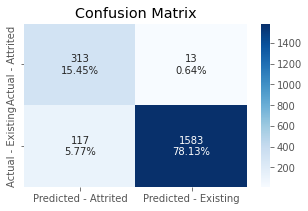

In [ ]:
make_confusion_matrix(adb_tuned, X_val, y_val)

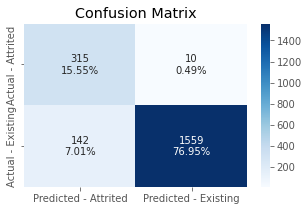

In [ ]:
make_confusion_matrix(adb_tuned, X_test, y_test)

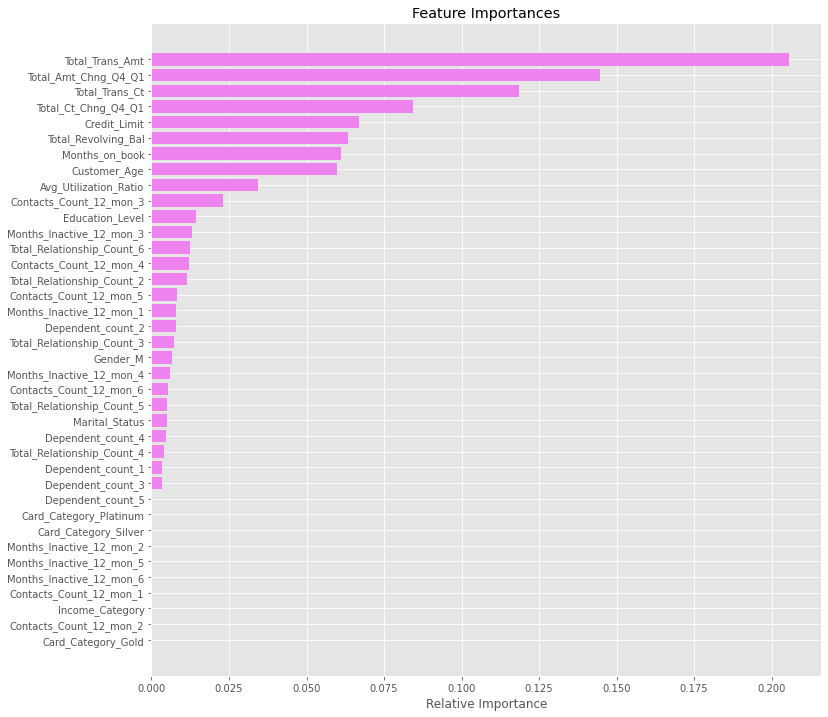

In [ ]:
feature_names = X_train.columns
importances = adb_tuned[1].feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

### XGboost downsampling data 

In [ ]:
%%time 
#Creating pipeline

pipe_xgboost_ran=make_pipeline(StandardScaler(), XGBClassifier(random_state=1,eval_metric='logloss'))

#Parameter grid to pass in random
param_grid={'xgbclassifier__n_estimators':np.arange(50,300,50),'xgbclassifier__scale_pos_weight':[2,10],
            'xgbclassifier__learning_rate':[0.01,0.1,0.2], 
            'xgbclassifier__subsample':[0.7,1]}


# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=pipe_xgboost_ran, param_distributions=param_grid,n_jobs = -1, n_iter=10, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un, y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'xgbclassifier__subsample': 0.7, 'xgbclassifier__scale_pos_weight': 10, 'xgbclassifier__n_estimators': 50, 'xgbclassifier__learning_rate': 0.01} with CV score=0.9897854526425955:
CPU times: user 873 ms, sys: 57.8 ms, total: 930 ms
Wall time: 16.4 s


In [ ]:
# Creating new pipeline with best parameters
xgb_tuned_model = make_pipeline(
    StandardScaler(),
    XGBClassifier(
        random_state=1,
        n_estimators=50,
        scale_pos_weight=10,
        subsample=0.7,
        learning_rate=0.01,
        eval_metric='logloss',
    ),
)

# Fit the model on training data
xgb_tuned_model.fit(X_train_un, y_train_un)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('xgbclassifier',
                 XGBClassifier(eval_metric='logloss', learning_rate=0.01,
                               n_estimators=50, random_state=1,
                               scale_pos_weight=10, subsample=0.7))])

In [ ]:
xgb_tuned_model_score = get_metrics_score(
    xgb_tuned_model, X_train, X_val, y_train, y_val
)

kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)

scoring = "recall"
xgb_down_cv = cross_val_score(
    estimator=xgb_tuned_model, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold
)


add_score_model(
    "XGB Tuned with Down Sampling", xgb_tuned_model_score, xgb_down_cv.mean()
)

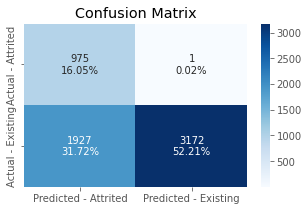

In [ ]:
make_confusion_matrix(xgb_tuned_model, X_train, y_train)

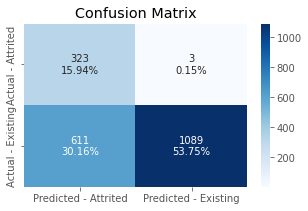

In [ ]:
make_confusion_matrix(xgb_tuned_model, X_val, y_val)

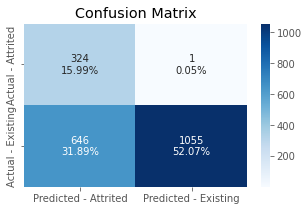

In [ ]:
make_confusion_matrix(xgb_tuned_model, X_test, y_test)

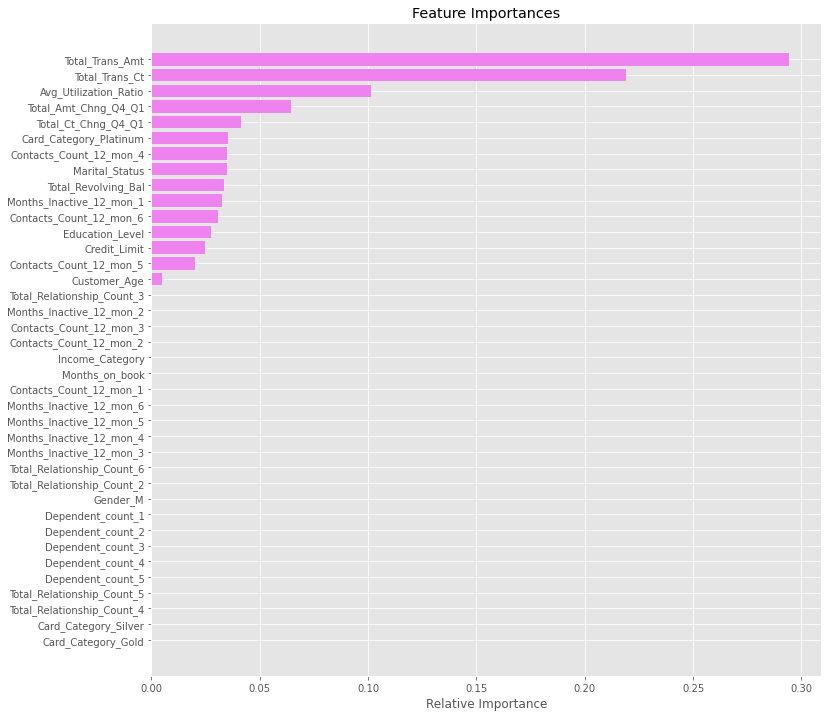

In [ ]:
feature_names = X_train.columns
importances = xgb_tuned_model[1].feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

### GBM with downsampling data

In [ ]:
%%time 
pipe_gb_rand = make_pipeline(StandardScaler(), GradientBoostingClassifier(random_state=1))

param_grid = {'gradientboostingclassifier__n_estimators':[100,200],
              'gradientboostingclassifier__max_depth':[10,20],
              'gradientboostingclassifier__min_samples_leaf': [10,20],
              'gradientboostingclassifier__min_samples_split': [25,35]
              }


scorer = metrics.make_scorer(metrics.recall_score)

#Calling RandomizedSearchCV
pipe_gb_rand = RandomizedSearchCV(estimator=pipe_gb_rand, param_distributions=param_grid,n_jobs = -1, n_iter=10, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
pipe_gb_rand.fit(X_train_un, y_train_un)

print("Best parameters are {} with CV score={}:" .format(pipe_gb_rand.best_params_,pipe_gb_rand.best_score_))

Best parameters are {'gradientboostingclassifier__n_estimators': 100, 'gradientboostingclassifier__min_samples_split': 35, 'gradientboostingclassifier__min_samples_leaf': 20, 'gradientboostingclassifier__max_depth': 20} with CV score=0.954924123495552:
CPU times: user 3.44 s, sys: 104 ms, total: 3.54 s
Wall time: 1min 23s


In [ ]:
gbm_tuned_model = make_pipeline(
    StandardScaler(),GradientBoostingClassifier(max_depth=20, min_samples_leaf=20,
                                            min_samples_split=35,
                                            n_estimators=100,
                                            random_state=1))

# Fit the model on training data
gbm_tuned_model.fit(X_train_un, y_train_un)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('gradientboostingclassifier',
                 GradientBoostingClassifier(max_depth=20, min_samples_leaf=20,
                                            min_samples_split=35,
                                            random_state=1))])

In [ ]:
gbm_tuned_model_score = get_metrics_score(
    gbm_tuned_model, X_train, X_val, y_train, y_val
)


kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)

scoring = "recall"
gbm_down_cv = cross_val_score(
    estimator=gbm_tuned_model, X=X_train_un, y=y_train_un, scoring=scoring, cv=kfold
)


add_score_model(
    "GBM Tuned with Down Sampling", gbm_tuned_model_score, gbm_down_cv.mean()
)

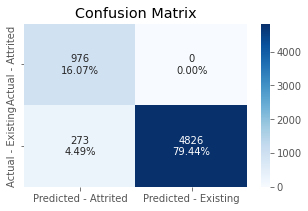

In [ ]:
make_confusion_matrix(gbm_tuned_model, X_train, y_train)

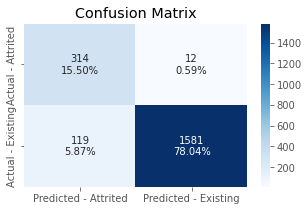

In [ ]:
make_confusion_matrix(gbm_tuned_model, X_val, y_val)

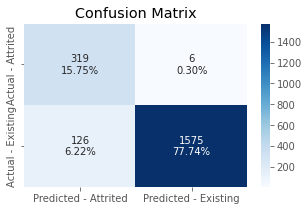

In [ ]:
make_confusion_matrix(gbm_tuned_model, X_test, y_test)

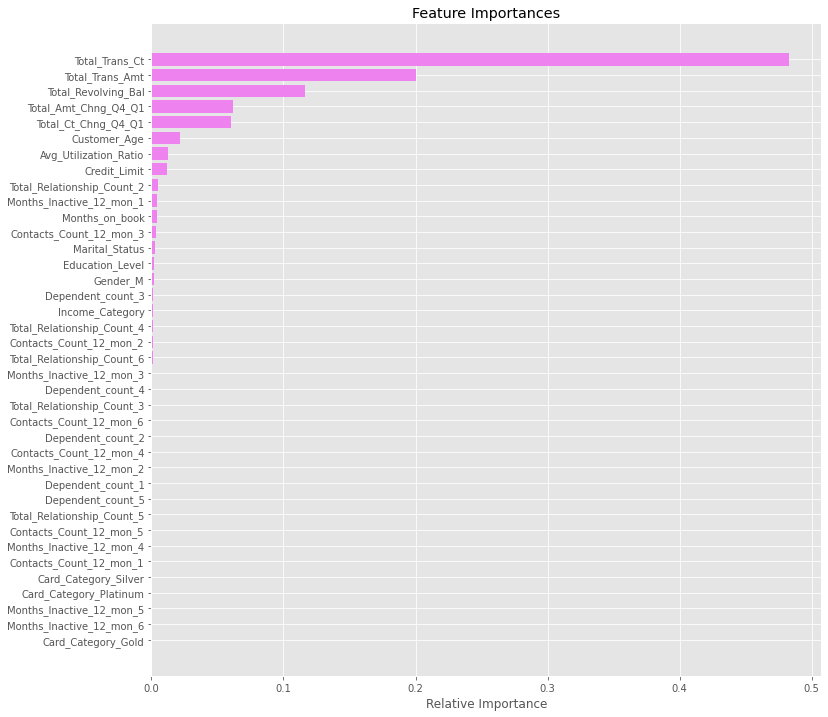

In [ ]:
feature_names = X_train.columns
importances = gbm_tuned_model[1].feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

## Comparing Model 

In [ ]:
comparison_frame = pd.DataFrame(
    {
        "Model": model_names,
        "Cross_Val_Score_Train": cross_val_train,
        "Train_Accuracy": acc_train,
        "Test_Accuracy": acc_test,
        "Train_Recall": recall_train,
        "Test_Recall": recall_test,
        "Train_Precision": precision_train,
        "Test_Precision": precision_test,
        "Train_F1": f1_train,
        "Test_F1": f1_test,
        "Train_ROC_AUC": roc_auc_train,
        "Test_ROC_AUC": roc_auc_test,
    }
)

# Sorting models in decreasing order of test recall
comparison_frame.sort_values(
    by=["Test_Recall", "Cross_Val_Score_Train"], ascending=False)

,Model,Cross_Val_Score_Train,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision,Train_F1,Test_F1,Train_ROC_AUC,Test_ROC_AUC
19,XGB Tuned with Down Sampling,0.99078,0.68263,0.69694,0.99898,0.99080,0.33598,0.34582,0.50284,0.51270,0.93625,0.93912
20,GBM Tuned with Down Sampling,0.95077,0.95506,0.93534,1.00000,0.96319,0.78143,0.72517,0.87730,0.82740,0.99826,0.98943
18,AdaBoost Tuned with Down Sampling,0.92317,0.94716,0.93583,0.99795,0.96012,0.75329,0.72791,0.85853,0.82804,0.98515,0.97513
16,Xgboost DownSampling,0.94977,0.96824,0.93090,0.97541,0.95092,0.96162,0.71429,0.96846,0.81579,0.99539,0.98841
15,Adaboost DownSampling,0.93027,0.94314,0.92300,0.94672,0.94479,0.93998,0.69058,0.94334,0.79793,0.99068,0.98154
14,GBM DownSampling,0.94875,0.97131,0.93139,0.97746,0.93865,0.96559,0.72000,0.97149,0.81491,0.99691,0.98774
13,Random forest DownSampling,0.93234,1.00000,0.93090,1.00000,0.93252,1.00000,0.72038,1.00000,0.81283,1.00000,0.97705
12,Bagging DownSampling,0.91593,0.99232,0.92300,0.98566,0.91411,0.99896,0.69953,0.99226,0.79255,0.99987,0.96898
10,Xgboost Oversampling,0.97490,0.98000,0.95805,0.98157,0.88957,0.97849,0.85546,0.98003,0.87218,0.99827,0.98770
17,dtree DownSampling,0.89440,1.00000,0.88598,1.00000,0.88957,1.00000,0.59794,1.00000,0.71517,1.00000,0.88743


### Final model selection 

* The GBM with hyper parameter tuning trained with undersampled dataset has a validation recall of 97 percent, validation accuracy of 94 percent, and precision of 74 percent, Validation AUC of 99 percent, and Cross Validation Mean of 96 percent. Furthermore, the model is free of bias and variation. As result our final model will be GBM Tuned with Down Sampling.

* The best recall on validation set is 99 percent for the XGBoost model with hyper parameter tweaking and trained with undersampled dataset, although accuracy is lower than human level accuracy (i,e, classifying everyone as non-attriting customers). As a result, this model will not be chosen as the final model.

## Productionizing the model

In [ ]:
# For dropping columns
columns_to_drop = [
    "clientnum",
    "credit_limit",
    "dependent_count",
    "months_on_book",
    "avg_open_to_buy",
    "customer_age",
]

# For masking a particular value in a feature
column_to_mask_value = "income_category"
value_to_mask = "abc"
masked_value = "Unknown"

# One-hot encoding columns
columns_to_encode = [
    "gender",
    "education_level",
    "marital_status",
    "income_category",
    "card_category",
]

# Numerical Columns
num_columns = [
    "total_relationship_count",
    "months_inactive_12_mon",
    "contacts_count_12_mon",
    "total_revolving_bal",
    "total_amt_chng_q4_q1",
    "total_trans_amt",
    "total_trans_ct",
    "total_ct_chng_q4_q1",
    "avg_utilization_ratio",
]

# Columns for null imputation with Unknown
columns_to_null_imp_unknown = ["education_level", "marital_status"]

In [ ]:
# Building a function to standardize columns

def feature_name_standardize(df: pd.DataFrame):
    df_ = df.copy()
    df_.columns = [i.replace(" ", "_").lower() for i in df_.columns]
    return df_

# Building a function to drop features

def drop_feature(df: pd.DataFrame, features: list = []):
    df_ = df.copy()
    if len(features) != 0:
        df_ = df_.drop(columns=features)
        
    return df_

# Building a function to treat incorrect value

def mask_value(df: pd.DataFrame, feature: str = None, value_to_mask: str = None, masked_value: str = None):
    df_ = df.copy()
    if feature != None and value_to_mask != None:
        if feature in df_.columns:
            df_[feature] = df_[feature].astype('object')
            df_.loc[df_[df_[feature] == value_to_mask].index, feature] = masked_value
            df_[feature] = df_[feature].astype('category')
            
    return df_

# Building a custom imputer

def impute_category_unknown(df: pd.DataFrame, fill_value: str):
    df_ = df.copy()
    for col in df_.select_dtypes(include='category').columns.tolist():
        df_[col] = df_[col].astype('object')
        df_[col] = df_[col].fillna('Unknown')
        df_[col] = df_[col].astype('category')
    return df_

# Building a custom data preprocessing class with fit and transform methods for standardizing column names

class FeatureNamesStandardizer(TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        """All SciKit-Learn compatible transformers and classifiers have the
        same interface. `fit` always returns the same object."""
        return self

    def transform(self, X):
        """Returns dataframe with column names in lower case with underscores in place of spaces."""
        X_ = feature_name_standardize(X)
        return X_
    
    
# Building a custom data preprocessing class with fit and transform methods for dropping columns

class ColumnDropper(TransformerMixin):
    def __init__(self, features: list):
        self.features = features

    def fit(self, X, y=None):
        """All SciKit-Learn compatible transformers and classifiers have the
        same interface. `fit` always returns the same object."""
        return self

    def transform(self, X):
        """Given a list of columns, returns a dataframe without those columns."""
        X_ = drop_feature(X, features=self.features)
        return X_
        
    

# Building a custom data preprocessing class with fit and transform methods for custom value masking

class CustomValueMasker(TransformerMixin):
    def __init__(self, feature: str, value_to_mask: str, masked_value: str):
        self.feature = feature
        self.value_to_mask = value_to_mask
        self.masked_value = masked_value

    def fit(self, X, y=None):
        """All SciKit-Learn compatible transformers and classifiers have the
        same interface. `fit` always returns the same object."""
        return self

    def transform(self, X):
        """Return a dataframe with the required feature value masked as required."""
        X_ = mask_value(X, self.feature, self.value_to_mask, self.masked_value)
        return X_
    
    
# Building a custom class to one-hot encode using pandas
class PandasOneHot(TransformerMixin):
    def __init__(self, columns: list = None):
        self.columns = columns

    def fit(self, X, y=None):
        """All SciKit-Learn compatible transformers and classifiers have the
        same interface. `fit` always returns the same object."""
        return self

    def transform(self, X):
        """Return a dataframe with the required feature value masked as required."""
        X_ = pd.get_dummies(X, columns = self.columns, drop_first=True)
        return X_
    
# Building a custom class to fill nulls with Unknown
class FillUnknown(TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        """All SciKit-Learn compatible transformers and classifiers have the
        same interface. `fit` always returns the same object."""
        return self

    def transform(self, X):
        """Return a dataframe with the required feature value masked as required."""
        X_ = impute_category_unknown(X, fill_value='Unknown')
        return X_

In [ ]:
# The static variables
# Random state and loss
seed = 1
loss_func = "logloss"

# Test and Validation sizes
test_size = 0.2
val_size = 0.25

# Dependent Varibale Value map
target_mapper = {"Attrited Customer": 1, "Existing Customer": 0}

df = BankChurners.copy()
cat_columns = df.select_dtypes(include="object").columns.tolist()
df[cat_columns] = df[cat_columns].astype("category")

### Dependent and independent variables

In [ ]:
X = df.drop(columns=["Attrition_Flag"])
y = df["Attrition_Flag"].map(target_mapper)

### Split data in Train, Validation and Test sets

In [ ]:
# Splitting data into training, validation and test set:
# first we split data into 2 parts, say temporary and test

X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=test_size, random_state=seed, stratify=y
)

# then we split the temporary set into train and validation

X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=val_size, random_state=seed, stratify=y_temp
)
print(X_train.shape, X_val.shape, X_test.shape)

(6075, 20) (2026, 20) (2026, 20)


### Undersampling

In [ ]:
under_sample = RandomUnderSampler(random_state=seed)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

### Pipeline

In [ ]:
# To Standardize feature names
feature_name_standardizer = FeatureNamesStandardizer()

# To Drop unnecessary columns
column_dropper = ColumnDropper(features=columns_to_drop)

# To Mask incorrect/meaningless value of a feature
value_masker = CustomValueMasker(
    feature=column_to_mask_value, value_to_mask=value_to_mask, masked_value=masked_value
)

# Missing value imputation
imputer = FillUnknown()

# To encode the categorical data
one_hot = OneHotEncoder(handle_unknown="ignore")

# To scale numerical columns
scaler = RobustScaler()


# creating a transformer for feature name standardization and dropping columns
cleanser = Pipeline(
    steps=[
        ("feature_name_standardizer", feature_name_standardizer),
        ("column_dropper", column_dropper),
        ("value_mask", value_masker),
        ("imputation", imputer),
    ]
)

# creating a transformer for data encoding

encode_transformer = Pipeline(steps=[("onehot", one_hot)])
num_scaler = Pipeline(steps=[("scale", scaler)])

preprocessor = ColumnTransformer(
    transformers=[
        ("encoding", encode_transformer, columns_to_encode),
        ("scaling", num_scaler, num_columns),
    ],
    remainder="passthrough",
)

# Model

gbm_tuned_model = GradientBoostingClassifier(
    n_estimators=700,
    max_features="auto",
    max_depth=25,
    min_samples_split=2,
    min_samples_leaf=15,
    random_state=seed,
)

# Creating new pipeline with best parameters
model_pipe = Pipeline(
    steps=[
        ("cleanse", cleanser),
        ("preprocess", preprocessor),
        ("model", gbm_tuned_model),
    ]
)
# Fit the model on training data
model_pipe.fit(X_train_un, y_train_un)

Pipeline(steps=[('cleanse',
                 Pipeline(steps=[('feature_name_standardizer',
                                  <__main__.FeatureNamesStandardizer object at 0x7fbeb0b12e10>),
                                 ('column_dropper',
                                  <__main__.ColumnDropper object at 0x7fbeb425b590>),
                                 ('value_mask',
                                  <__main__.CustomValueMasker object at 0x7fbeb0b12fd0>),
                                 ('imputation',
                                  <__main__.FillUnknown object at 0x7fbeb06b8110>)])),
                ('preprocess',
                 ColumnTran...
                                                                   RobustScaler())]),
                                                  ['total_relationship_count',
                                                   'months_inactive_12_mon',
                                                   'contacts_count_12_mon',
                     

In [ ]:
print("Accuracy on Test is: {}%".format(round(model_pipe.score(X_test, y_test) * 100, 0)))

Accuracy on Test is: 94.0%


# Actionable Insights & Recommendations

The most important features to understand customer credit card churn, are

1. Total Transaction Count
2. Total Transaction Amount
3. Total Revolving Balance
4. Total Amount Change Q4 to Q1
5. Total Count Change Q4 to Q1
6. Total Relationship Count

* Attrited consumers have a lower average usage ratio.

* According to the EDA Customers between the ages of 36 and 55, with a doctorate or postgraduate degree, or who were female, attrited more. One reason could be that a competing bank is offering them better deals, resulting in fewer people using this bank's credit card.

* According to the EDA, Customers who had a significant number of interactions with the bank in the previous year have attrited. It needs to be looked into whether there were any unresolved customer issues that led to clients quitting the bank.

* All of these characteristics are inversely connected with the Attrition Flag, which means that the lower the value of these characteristics, the more likely a client will attrite.


* To increase client connections with the bank, the bank should engage with customers more frequently and give them with a variety of offers and schemes.


* Banks should offer credit card cashback programs to encourage people to use their cards more frequently.


* Customers that use their credit cards frequently should have their credit limits increased by the bank. This should result in more credit card purchases and transactions.

* Customer attrition is indicated by a lower credit card transaction count, a lower revolving balance, and a lower transaction amount. Lower transaction indicates that the client is not using the credit card; therefore, the bank should give additional rewards, cashback, or other incentives to encourage customers to use the credit card more frequently.

* According to the EDA, customers who have more products with the bank are less likely to attrite.

* Such consumers can be offered more products by the bank, which will encourage them to buy more items, allowing the bank to retain them.

* Customers who have been inactive for a month are more likely to leave. Customers like these should be prioritized by the bank.

* Interest rate of 0% EMI on credit cards is another offer that may be made to customers to encourage them to buy higher-cost products using credit cards and convert the spending to EMI, hence increasing overall transaction amounts and transaction counts. The equilibrium would also be beautifully revolving.


* In addition to the standard credit cards, the bank might offer credit cards tailored to online shopping (with percent cashback offers) or online food ordering. The card will be utilized more frequently as a result of this.


* We can anticipate which customers are likely to attrite using our model, and based on the predicted probability, at least the top 20%-30% of customers can be contacted to discuss credit card offers, credit limit increases, and other retention strategies.



In [ ]:
%%shell
jupyter nbconvert --to html /content/Credit_Card_Users_Churn_Prediction.ipynb

[NbConvertApp] Converting notebook /content/Credit_Card_Users_Churn_Prediction.ipynb to html
[NbConvertApp] Writing 20537088 bytes to /content/Credit_Card_Users_Churn_Prediction.html
